 # projet 6 : Classifiez automatiquement des biens de consommation

# **Partie 1**

# 1.1 La problématique

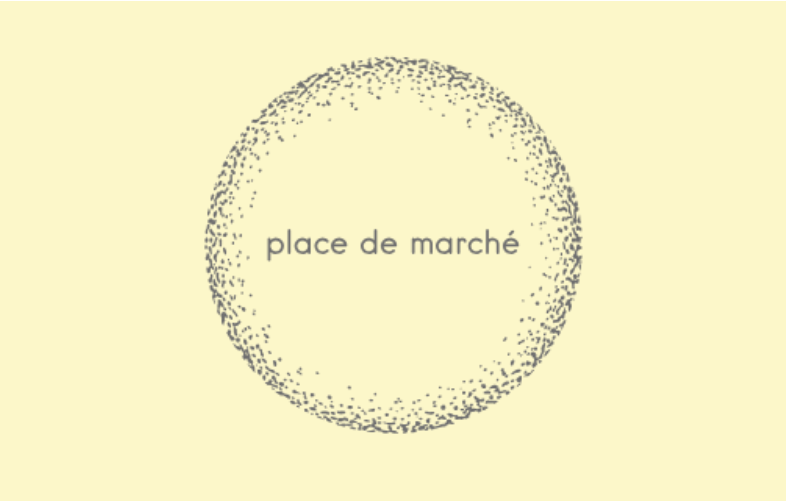

In [1]:
from IPython.display import Image
Image("C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Ressources/PlaceDeMarche.png")

- **Contexte :L’entreprise "Place de marché” souhaite lancer une marketplace e-commerce.**

- **L'objectif : Réalisation une étude de faisabilité d'un moteur de classification automatique d’articles, en utilisant leur image et leur description sur le jeu de données d'articles disponible dans la première pièce jointe.**


In [2]:
# Auteur : Mohamed MERAH
# Date: Février 2024
# OpenClassrooms 2023-2024

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno


import P6_fonction as fcP6
from turtle import color

from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder

#import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk import bigrams
from nltk import FreqDist
from string import punctuation
from nltk.corpus import stopwords

from nltk.stem.wordnet import WordNetLemmatizer
from tensorflow.keras.preprocessing.text import Tokenizer
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

import nltk
nltk.download('wordnet')
import pickle
#import nltk nltk.download('wordnet')

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.decomposition import NMF


from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras import metrics as kmetrics
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model
import gensim
from tqdm import tqdm

import tensorflow as tf
import tensorflow.keras
from tensorflow.keras import backend as K
from transformers import TFAutoModel
from os import listdir
from matplotlib.image import imread
from skimage.transform import resize
import cv2
import time
from sklearn import cluster, metrics
import tensorflow_hub as hub

from sklearn import manifold, decomposition
import string
from wordcloud import WordCloud

import tensorflow as tf
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalAveragePooling1D, Flatten, Dense, Dropout 
from tensorflow.keras.layers import Rescaling, RandomFlip, RandomRotation, RandomZoom
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.utils import to_categorical
from PIL import Image, ImageOps, ImageFilter

import sys
if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")
import os   
os.environ["TF_KERAS"]='1'
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

C:\Users\misso\AppData\Local\Temp\ipykernel_36880\2879858508.py:5: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


C:\Users\misso\Desktop\Formation_DS_23_24_MERAH\2-Projet\6- Projet 6\Code\venvP6\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\misso\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


Num GPUs Available:  0


# 1.2 Importation des données

In [3]:
## Lire à partir du fichier .csv et le stocker dans une trame de données
df = pd.read_csv("C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Ressources/flipkart_com-ecommerce_sample_1050.csv",
                 sep=',', 
                # index_col = 'uniq_id',
                 encoding ='utf-8')

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [5]:
df.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [6]:
df.shape

(1050, 15)

# 1.3 Qualité du jeu de données

In [7]:
fcP6.Nb_Data_Dupliq(df)

Nombre de données dupliquées : 0


In [8]:
df.head(5)

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [9]:
fcP6.valeurs_manquantes(df)

,Variable,Missing values,Missing (%)
0,uniq_id,0,0.000000
1,crawl_timestamp,0,0.000000
2,product_url,0,0.000000
3,product_name,0,0.000000
4,product_category_tree,0,0.000000
5,pid,0,0.000000
6,retail_price,1,0.000952
7,discounted_price,1,0.000952
8,image,0,0.000000
9,is_FK_Advantage_product,0,0.000000


- **Il y a 2.17% de valeurs manquantes dans le dataframe.**
- **Ces valeurs sont essentiellement situées dans la variable 'brand'.**
- **Il y en a également dans chacune des variables suivantes : 'retail_price', 'discounted_price', et 'product_specifications'.**

Nombre de lignes : 1050
Nombre de colonnes : 15
Nombre total de cellules manquantes : 341
Le jeux de données est rempli à 97.83%
et il a 2.17% de données manquantes
 
 


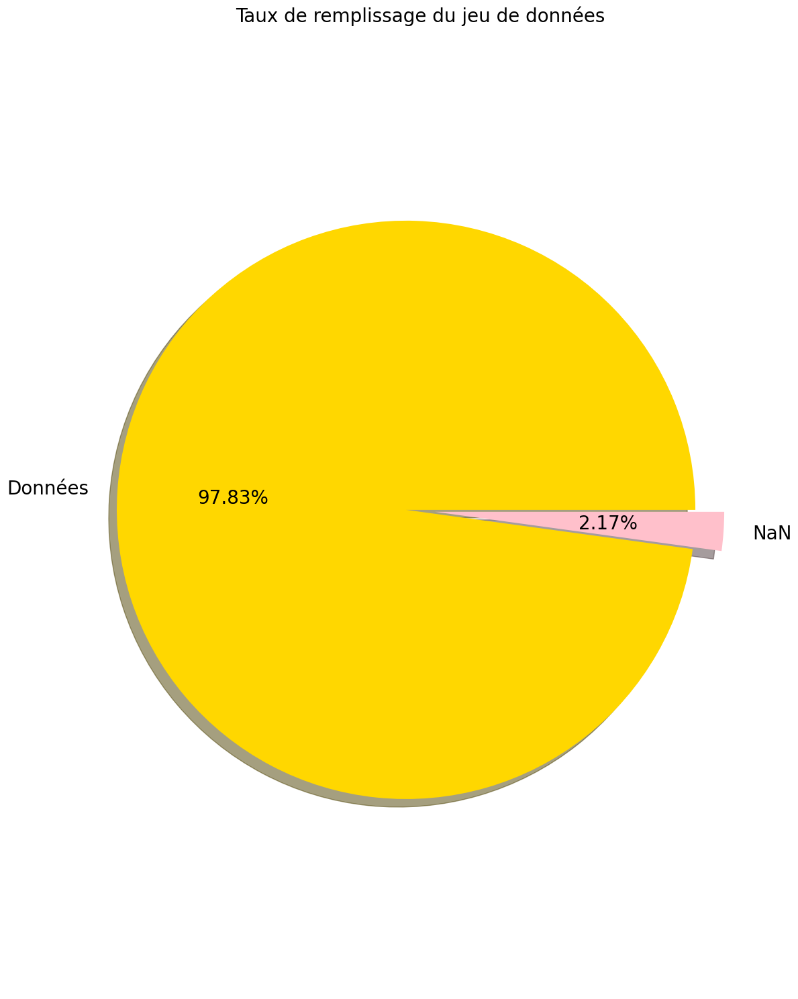

In [10]:
fcP6.Graph_Pie_NaN(df)

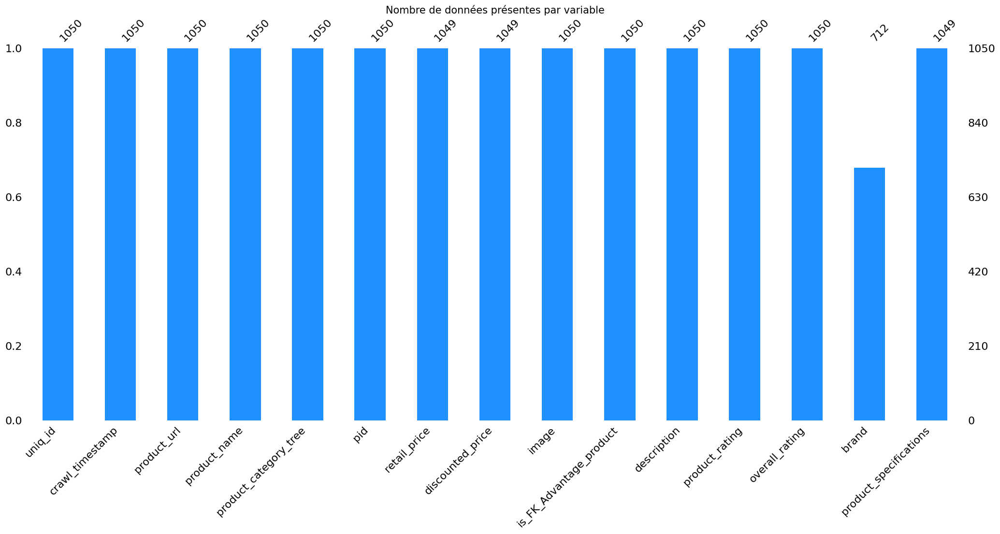

In [11]:
fcP6.bar_missing(df)

In [12]:
fcP6.describe_dataset({'sample e-commerce':[df, "Produits"]})

Les données se décomposent en 1 fichier(s): 



,Nom du fichier,Nb de lignes,Nb de colonnes,Description
1,sample e-commerce,1050,15,Produits


In [13]:
fcP6.Liste_Colonne_Seuil_NaN(df,0)

Nombre de colonnes ayant plus de 30% valeur manquantes est : 15
La liste de colonnes ayant plus de 30% de valeurs manquantes est : ['brand', 'retail_price', 'discounted_price', 'product_specifications', 'uniq_id', 'crawl_timestamp', 'product_url', 'product_name', 'product_category_tree', 'pid', 'image', 'is_FK_Advantage_product', 'description', 'product_rating', 'overall_rating']


,Variable,Taux_Data_NaN
0,brand,32.190476
1,retail_price,0.095238
2,discounted_price,0.095238
3,product_specifications,0.095238
4,uniq_id,0.000000
5,crawl_timestamp,0.000000
6,product_url,0.000000
7,product_name,0.000000
8,product_category_tree,0.000000
9,pid,0.000000


# 1.4 Préparation du jeu de données

On dispose de 1 fichier .csv avec 1050 produits et 15 variables. 
Ce jeu de donnée donne pour chaque produit à vendre ses caractéristiques. 

**Les variables intéréssantes pour notre projet est les suivantes:**

   - **uniq_id:** identifiant unique du produit
   - **product_name:** nom du produit
   - **product_categoriy_tree:** arbre des catégories avec plusieurs niveaux. Le premier niveau est formé par 7 catégories.
   - **image:** nom de l'image qui correspond au produit
   - **description:** description du produit



In [14]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [15]:
df.describe()

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


In [16]:
data= df.loc[:, ['uniq_id', 'product_name', 'product_category_tree', 'image', 'description']]
data.head(5)

,uniq_id,product_name,product_category_tree,image,description
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...
3,d4684dcdc759dd9cdf41504698d737d8,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,6325b6870c54cd47be6ebfbffa620ec7,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...


In [17]:
fcP6.Liste_Colonne_Seuil_NaN(data,0)

Nombre de colonnes ayant plus de 30% valeur manquantes est : 5
La liste de colonnes ayant plus de 30% de valeurs manquantes est : ['uniq_id', 'product_name', 'product_category_tree', 'image', 'description']


,Variable,Taux_Data_NaN
0,uniq_id,0.0
1,product_name,0.0
2,product_category_tree,0.0
3,image,0.0
4,description,0.0


In [18]:
for idx, ser in data.iloc[:1].iterrows():
    for i in range(data.shape[1]):
        print(data.columns[i] + ":")
        print(ser[i] + "\n")

uniq_id:
55b85ea15a1536d46b7190ad6fff8ce7

product_name:
Elegance Polyester Multicolor Abstract Eyelet Door Curtain

product_category_tree:
["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]

image:
55b85ea15a1536d46b7190ad6fff8ce7.jpg

description:
Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first

# 1.4.1 Exploration des catégories

In [19]:
value_counts_product_name = data['product_category_tree'].value_counts()
value_counts_product_name

product_category_tree
["Home Furnishing >> Bed Linen >> Blankets, Quilts & Dohars"]                         56
["Kitchen & Dining >> Coffee Mugs >> Prithish Coffee Mugs"]                           26
["Watches >> Wrist Watches >> Maxima Wrist Watches"]                                  23
["Kitchen & Dining >> Coffee Mugs >> Rockmantra Coffee Mugs"]                         22
["Home Furnishing >> Bath Linen >> Towels"]                                           19
                                                                                      ..
["Home Decor & Festive Needs >> Showpieces >> Ethnic >> Infinity India Ethnic"]        1
["Home Decor & Festive Needs >> Showpieces >> Ethnic >> Ravishing Variety Ethnic"]     1
["Home Decor & Festive Needs >> Showpieces >> Ethnic >> Pg handicrafts Ethnic"]        1
["Home Decor & Festive Needs >> Showpieces >> Ethnic >> Homedesires Ethnic"]           1
["Watches >> Wrist Watches >> Petrol Wrist Watches"]                                   1

In [20]:
df[['product_category_tree']]

,product_category_tree
0,"[""Home Furnishing >> Curtains & Accessories >>..."
1,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T..."
2,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T..."
3,"[""Home Furnishing >> Bed Linen >> Bedsheets >>..."
4,"[""Home Furnishing >> Bed Linen >> Bedsheets >>..."
...,...
1045,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."
1046,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."
1047,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."
1048,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."


 - Nous allons séparer en plusieurs variables les différents niveaux de catégories.

In [21]:
df_cat = df.copy()

In [22]:
df_cat['product_category_tree'].str.count(" >> ").max()

6

In [23]:
df_cat['product_category_tree'].str.count(" >> ").median()

3.0

In [24]:
df_cat['product_category_tree'].str.count(" >> ").min()

1

In [25]:
# On récupère la colomne "product_category_tree"
list_categories_0, list_categories_1 = [], []
for txt in df_cat["product_category_tree"] :
    
    list_categories_0.append(txt.split(">>")[0].split("\"")[1].strip()) # split du nom par >> et on récupère la première partie
    list_categories_1.append(txt.split(">>")[1].strip()) # split du nom par >> et on récupère la première partie

# Création d'une nouvelle série catégorie    
df_cat["category_0"] = pd.Series(list_categories_0)
df_cat["category_1"] = pd.Series(list_categories_1)

print("Il y a {} catégories de niveau 1 et {} categories de niveau 2".format(df_cat["category_0"].nunique(), df_cat["category_1"].nunique()))

Il y a 7 catégories de niveau 1 et 63 categories de niveau 2


In [26]:
def split_categories(categories):
    categories = categories.replace('["', "").replace('"]', "")
    cat_list = categories.split(' >> ')
    
    cat = pd.Series(dtype='object')
    for i in range(0, len(cat_list)):
        cat["cat_{}".format(i+1)] = cat_list[i]
    
    return cat

In [27]:
df_category = pd.DataFrame()
df_category = df_cat['product_category_tree'].apply(split_categories)

In [28]:
df_category

,cat_1,cat_2,cat_3,cat_4,cat_5,cat_6,cat_7
0,Home Furnishing,Curtains & Accessories,Curtains,Elegance Polyester Multicolor Abstract Eyelet ...,NaN,NaN,NaN
1,Baby Care,Baby Bath & Skin,Baby Bath Towels,Sathiyas Baby Bath Towels,"Sathiyas Cotton Bath Towel (3 Bath Towel, Red,...",NaN,NaN
2,Baby Care,Baby Bath & Skin,Baby Bath Towels,Eurospa Baby Bath Towels,Eurospa Cotton Terry Face Towel Set (20 PIECE ...,NaN,NaN
3,Home Furnishing,Bed Linen,Bedsheets,SANTOSH ROYAL FASHION Bedsheets,SANTOSH ROYAL FASHION Cotton Printed King size...,NaN,NaN
4,Home Furnishing,Bed Linen,Bedsheets,Jaipur Print Bedsheets,Jaipur Print Cotton Floral King sized Double B...,NaN,NaN
...,...,...,...,...,...,...,...
1045,Baby Care,Baby & Kids Gifts,Stickers,Oren Empower Stickers,NaN,NaN,NaN
1046,Baby Care,Baby & Kids Gifts,Stickers,Wallmantra Stickers,NaN,NaN,NaN
1047,Baby Care,Baby & Kids Gifts,Stickers,Uberlyfe Stickers,NaN,NaN,NaN
1048,Baby Care,Baby & Kids Gifts,Stickers,Wallmantra Stickers,NaN,NaN,NaN


In [29]:
fcP6.valeurs_manquantes(df_category)

,Variable,Missing values,Missing (%)
0,cat_1,0,0.000000
1,cat_2,0,0.000000
2,cat_3,3,0.002857
3,cat_4,371,0.353333
4,cat_5,645,0.614286
5,cat_6,923,0.879048
6,cat_7,993,0.945714


- **On constate que seules les 3 premières catégories sont quasiment toutes renseignées. Nous décidons donc de ne garder quel celles-ci et de remplacer les 3 valeurs manquantes par 'None'**

In [30]:
df_category.drop(["cat_{}".format(i) for i in range(4,8)], axis=1, inplace=True)

In [31]:
df_category.fillna('None', inplace=True)

In [32]:
df_category

,cat_1,cat_2,cat_3
0,Home Furnishing,Curtains & Accessories,Curtains
1,Baby Care,Baby Bath & Skin,Baby Bath Towels
2,Baby Care,Baby Bath & Skin,Baby Bath Towels
3,Home Furnishing,Bed Linen,Bedsheets
4,Home Furnishing,Bed Linen,Bedsheets
...,...,...,...
1045,Baby Care,Baby & Kids Gifts,Stickers
1046,Baby Care,Baby & Kids Gifts,Stickers
1047,Baby Care,Baby & Kids Gifts,Stickers
1048,Baby Care,Baby & Kids Gifts,Stickers


In [33]:
# Ajouter les cols au df
data_category= pd.concat(
    [data,df_category],
    sort=False,
    axis=1
)

In [34]:
data_category.head(3)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,Baby Bath Towels


In [35]:
le = LabelEncoder()
le.fit(data_category["cat_1"])
data_category["label"] = le.transform(data_category["cat_1"])

In [36]:
fcP6.valeurs_manquantes(data_category)

,Variable,Missing values,Missing (%)
0,uniq_id,0,0.0
1,product_name,0,0.0
2,product_category_tree,0,0.0
3,image,0,0.0
4,description,0,0.0
5,cat_1,0,0.0
6,cat_2,0,0.0
7,cat_3,0,0.0
8,label,0,0.0


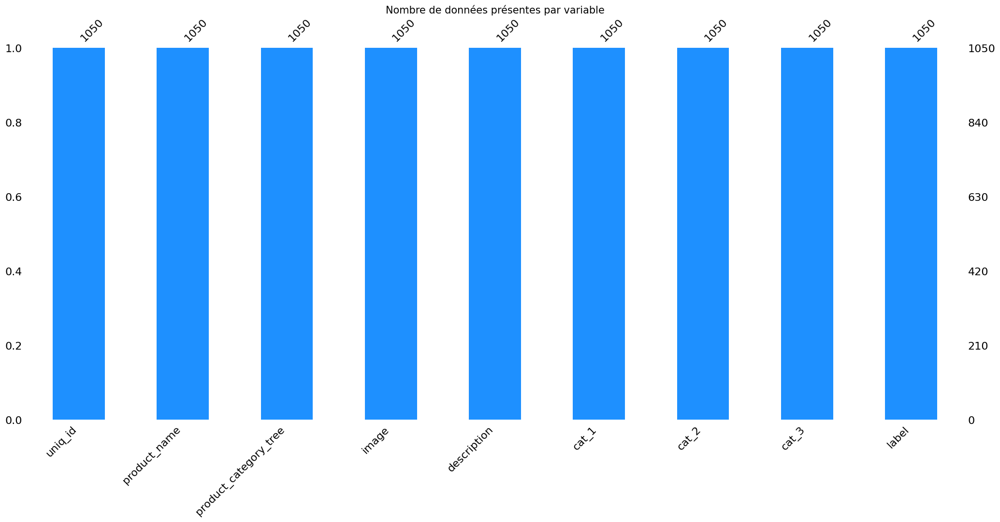

In [37]:
fcP6.bar_missing(data_category)

In [38]:
values_count_cat1= data_category['cat_1'].value_counts()
values_count_cat1=pd.DataFrame(values_count_cat1)
values_count_cat1

,count
cat_1,
Home Furnishing,150
Baby Care,150
Watches,150
Home Decor & Festive Needs,150
Kitchen & Dining,150
Beauty and Personal Care,150
Computers,150


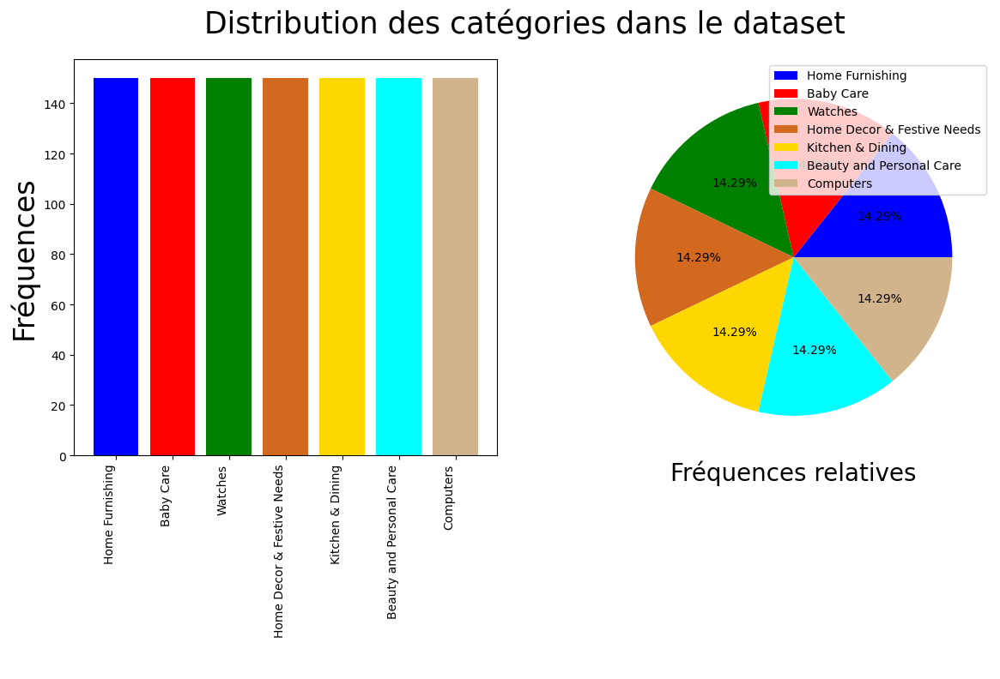

In [39]:
fig = fcP6.categorical_distribution(data_category['cat_1'])

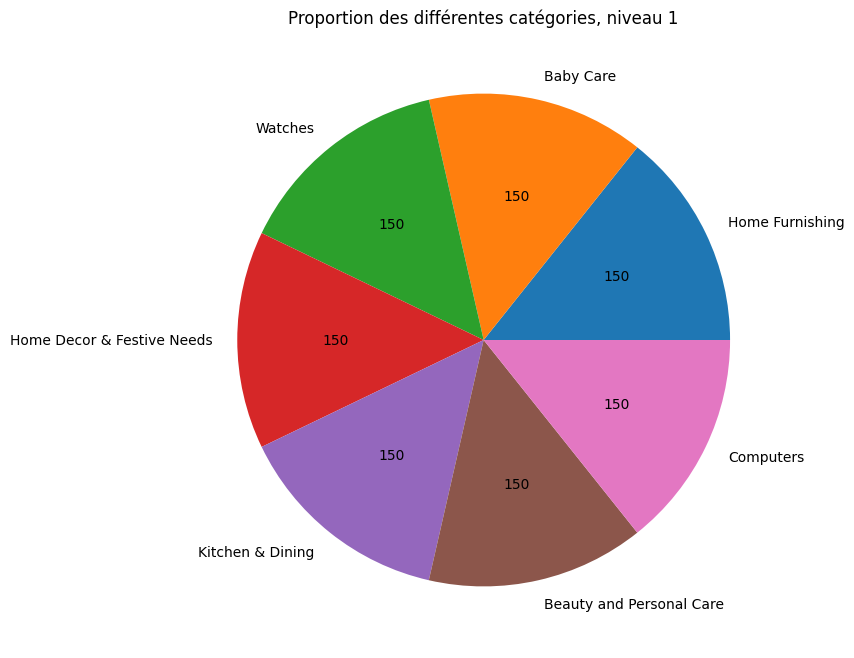

In [40]:
# Pieplot de la répartition des catégories du niveau 1
sns.color_palette("pastel")
df = data_category.cat_1.value_counts()

fig = plt.figure(1, figsize=(15, 8))
plt.title("Proportion des différentes catégories, niveau 1")
plt.pie(df, labels=list(df.index), autopct='150')
plt.show()

- **On constate que pour la catégorie principale des produits ('cat_1'), est parfaitement équilibrée avec 150 produits dans chaque catégorie.**

In [41]:
values_count_cat2= data_category['cat_2'].value_counts()
values_count_cat2=pd.DataFrame(values_count_cat2)
values_count_cat2

,count
cat_2,
Wrist Watches,149
Laptop Accessories,87
Infant Wear,84
Coffee Mugs,74
Showpieces,71
...,...
Consumables & Disposables,1
TRUE Home Decor & Festive Needs,1
JMD Home Furnishing,1


In [42]:
values_count_cat3= data_category['cat_3'].value_counts()
values_count_cat3=pd.DataFrame(values_count_cat3)
values_count_cat3

,count
cat_3,
Deodorants,65
"Blankets, Quilts & Dohars",57
Routers,49
Baby Girls' Clothes,49
USB Gadgets,38
...,...
Portable Projectors,1
Changing Tables,1
Titan Wrist Watches,1


In [43]:
data_category.shape

(1050, 9)

# **Partie 2 : Traitement des données textuelles**

# 2.1 Nettoyage du texte

- **Stop-words** :La première manipulation souvent effectuée dans le traitement du texte est la suppression de ce qu'on appelle en anglais les stopwords. Ce sont les mots très courants dans la langue étudiée ("et", "à", "le"... en français) qui n'apportent pas de valeur informative pour la compréhension du "sens" d'un document et corpus. Ils sont très fréquents et ralentissent notre travail : nous souhaitons donc les supprimer.
- **Tokeniser:** découper un texte en entités plus petites appelées tokens
- **Stemmer:** Cela consiste à ne conserver que la racine des mots étudiés. L'idée étant de supprimer les suffixes, préfixes et autres des mots afin de ne conserver que leur origine. C'est un procédé plus simple que la lemmatisation et plus rapide à effectuer puisqu'on tronque les mots essentiellement contrairement à la lemmatisation qui nécessite d'utiliser un dictionnaire.
- **Lemmatiser:** Le processus de « lemmatisation » consiste à représenter les mots (ou « lemmes » 😉) sous leur forme canonique. Par exemple pour un verbe, ce sera son infinitif. Pour un nom, son masculin singulier. L'idée étant encore une fois de ne conserver que le sens des mots utilisés dans le corpus.

In [44]:
data_category[['description']]

,description
0,Key Features of Elegance Polyester Multicolor ...
1,Specifications of Sathiyas Cotton Bath Towel (...
2,Key Features of Eurospa Cotton Terry Face Towe...
3,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,Key Features of Jaipur Print Cotton Floral Kin...
...,...
1045,Oren Empower Extra Large Self Adhesive Sticker...
1046,Wallmantra Large Vinyl Sticker Sticker (Pack o...
1047,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...
1048,Buy Wallmantra Medium Vinyl Sticker Sticker fo...


In [45]:
data_category['description'].iloc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

Nous créons une liste de stopwords à éliminer comprenant les stops words du vocabulaire anglais ainsi que la ponctuation. Ce sont les mots très courants dans la langue étudiée ("et", "à", "le"... en français) qui n'apportent pas de valeur informative pour la compréhension du "sens" d'un document.

In [47]:
data_category.shape

(1050, 9)

In [48]:
# 'name_description_' est une variable qui contient le nom
# et la description du produit concaténés
data_category['name_description_'] = data_category.product_name \
                            + ' ' + data_category.description

# 2.1.1 Nettoyage 1 : **name_description_clean**

**'name_description_clean'** est une préparation du texte du variable "description" et "product_name".
Elle consiste à mettre le texte

- Passage en Minuscule
- Suppression des Stop-words et des variable numériques
- Tokeniser
- Stemmer
- Lemmatiser

In [49]:
# 'name_description_' est une variable qui contient le nom et la description du produit concaténés
data_category['name_description_'] = data_category.product_name \
                            + ' ' + data_category.description

In [50]:
# "name_description" est le champ qui contient le nom et la description avec un prétraitement et lem et stem
data_category['name_description_clean'] = data_category.name_description_.apply(lambda doc: fcP6.preprocess_text_lem_stem(doc))

In [51]:
print("Avant le nettoyage du texte =====================================")

Avant le nettoyage du texte =====================================


In [52]:
data_category['name_description_'].iloc[0]

'Elegance Polyester Multicolor Abstract Eyelet Door Curtain Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant

In [53]:
print("Aorès le nettoyage texte =====================================")

Aorès le nettoyage texte =====================================


In [54]:
data_category.name_description_clean[0]

'eleg polyest multicolor abstract eyelet door curtain key featur eleg polyest multicolor abstract eyelet door curtain floral curtain polyest multicolor abstract eyelet door curtain height pack price curtain enhanc look interior curtain made high qualiti polyest fabric featur eyelet style stitch metal ring make room environ romant love curtain ant wrinkl anti shrinkag eleg appar home bright modernist appeal design surreal attent sure steal heart contemporari eyelet valanc curtain slide smoothli draw apart first thing morn welcom bright sun ray want wish good morn whole world draw close even creat special moment joyou beauti given sooth print bring home eleg curtain softli filter light room get right amount sunlight eleg polyest multicolor abstract eyelet door curtain height pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens length box number content sale packag pack sale packag curtain bodi design materi polyest'

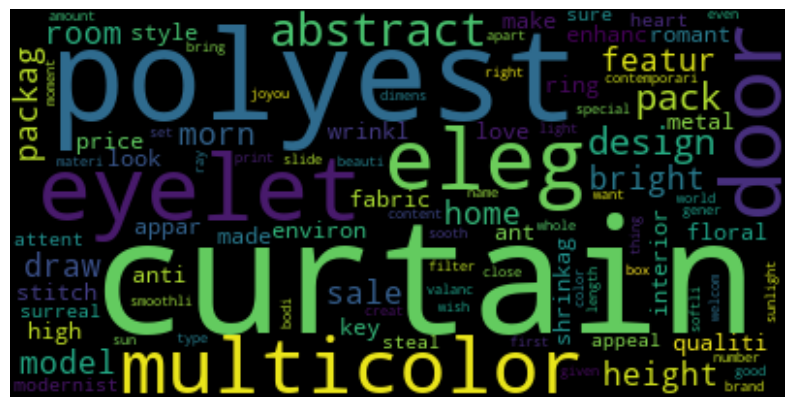

In [55]:
fcP6.Fc_WordCloud(data_category.name_description_clean[0])

# 2.1.2 Nettoyage 2 :  **description_clean**

'description_clean' est une préparation du texte du variable "description" .
 Elle consiste à mettre le texte:

- Passage en Minuscule
- Suppression des Stop-words et des variable numériques
- Tokeniser
- Stemmer
- Lemmatiser


In [56]:
print("Avant le nettoyage du texte =====================================")

Avant le nettoyage du texte =====================================


In [57]:
data_category['description'].iloc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

In [58]:
# "name_description_clean" est le champ qui contient le nom et la description avec un prétraitement et lem et stem
data_category['description_clean'] = data_category.description.apply(lambda doc: fcP6.preprocess_text_lem_stem(doc))

In [59]:
data_category['description_clean'].iloc[0]

'key featur eleg polyest multicolor abstract eyelet door curtain floral curtain polyest multicolor abstract eyelet door curtain height pack price curtain enhanc look interior curtain made high qualiti polyest fabric featur eyelet style stitch metal ring make room environ romant love curtain ant wrinkl anti shrinkag eleg appar home bright modernist appeal design surreal attent sure steal heart contemporari eyelet valanc curtain slide smoothli draw apart first thing morn welcom bright sun ray want wish good morn whole world draw close even creat special moment joyou beauti given sooth print bring home eleg curtain softli filter light room get right amount sunlight eleg polyest multicolor abstract eyelet door curtain height pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens length box number content sale packag pack sale packag curtain bodi design materi polyest'

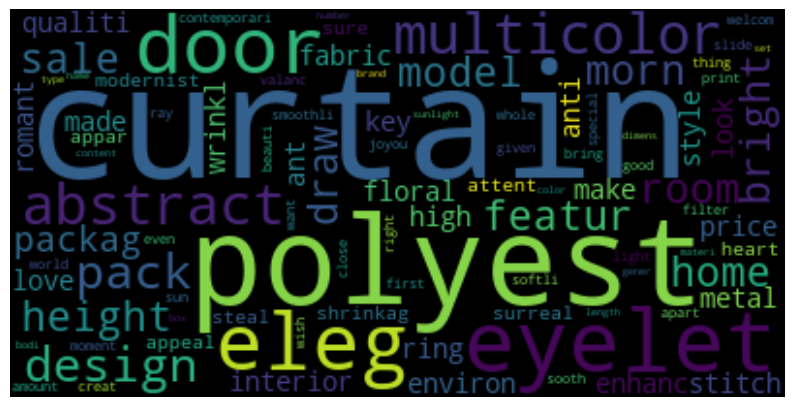

In [60]:
fcP6.Fc_WordCloud(data_category.description_clean[0])

In [61]:
data_category.to_csv("data_text_clean.csv")

In [62]:
df_text_clean=data_category.copy()

# 2.2 Les mots les plus fréquents



**Nous affichons les mots qui reviennent le plus féquemment dans les descriptions.**


In [63]:
stopwords_nltk = set(stopwords.words('english'))
stopwords_punct = set(punctuation)
stop_words = set.union(stopwords_nltk, stopwords_punct)
data_category['descr_bow'] = data_category['description'].apply(lambda x : fcP6.transform_bow_fct(x, stop_words))
data_category['length_bow'] = data_category['descr_bow'].apply(lambda x : len(word_tokenize(x)))
print("max length bow : ", data_category['length_bow'].max())

max length bow :  379


Text(0.5, 1.0, 'Les 20 mots les plus fréquents des descriptions')

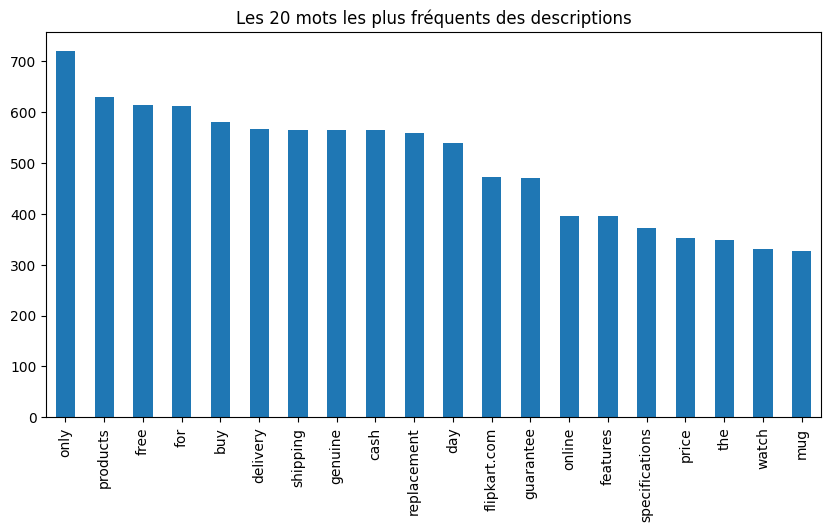

In [64]:
tokens = word_tokenize(' '.join(data_category['descr_bow'].values))
# on compte la fréquence de chaque mot 
freq_desc = pd.Series(FreqDist(tokens))

fig = plt.figure(figsize=(10,5))
freq_desc.sort_values(ascending=False)[0:20].plot.bar()
plt.title('Les 20 mots les plus fréquents des descriptions')

**Nous affichons désormais les mots qui reviennent le plus féquemment dans les descriptions pour chaque cluster.**

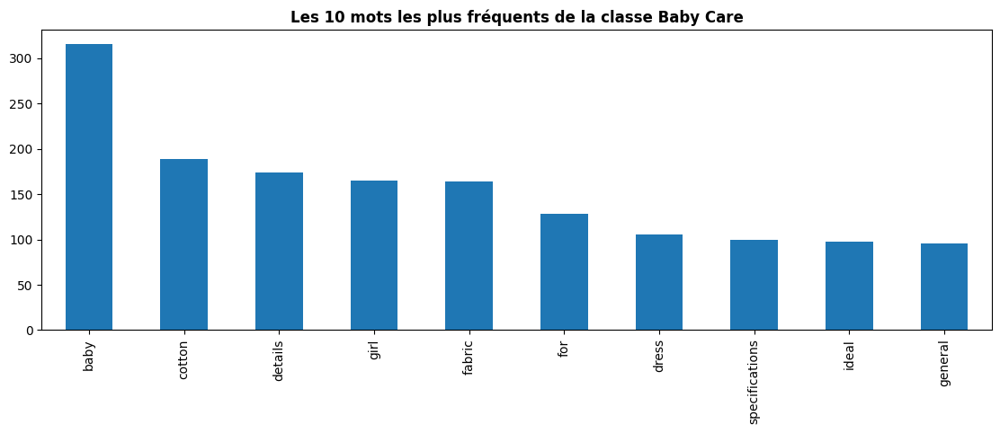

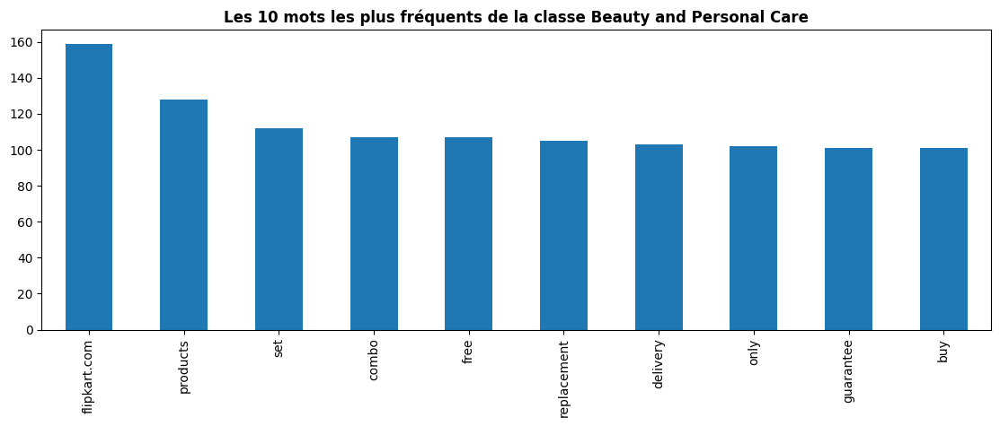

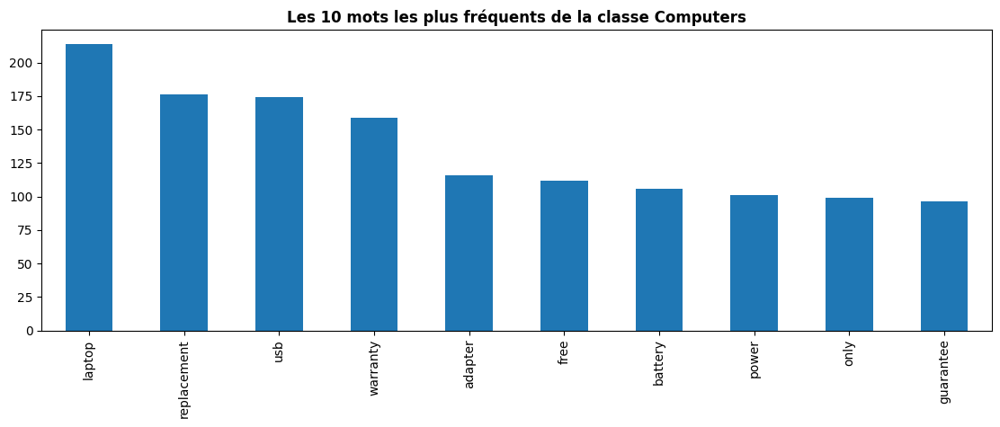

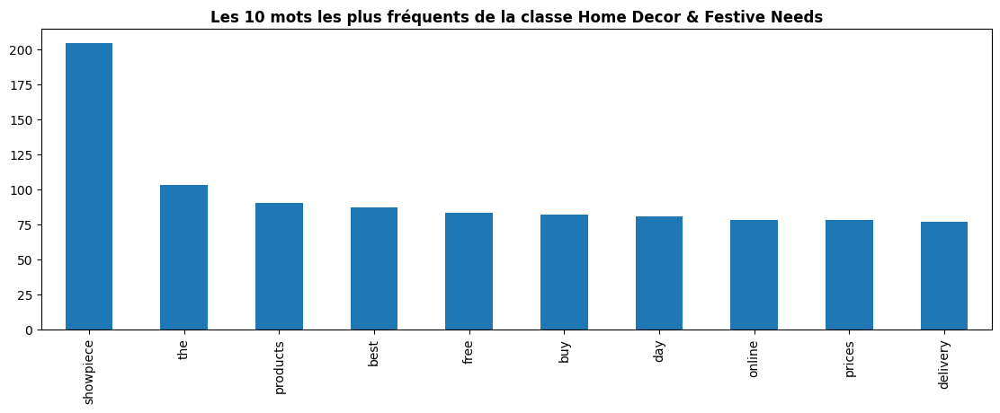

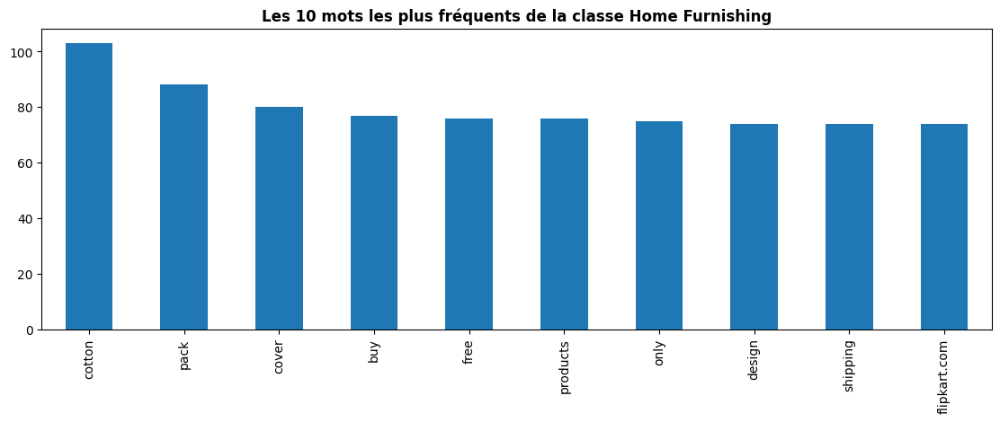

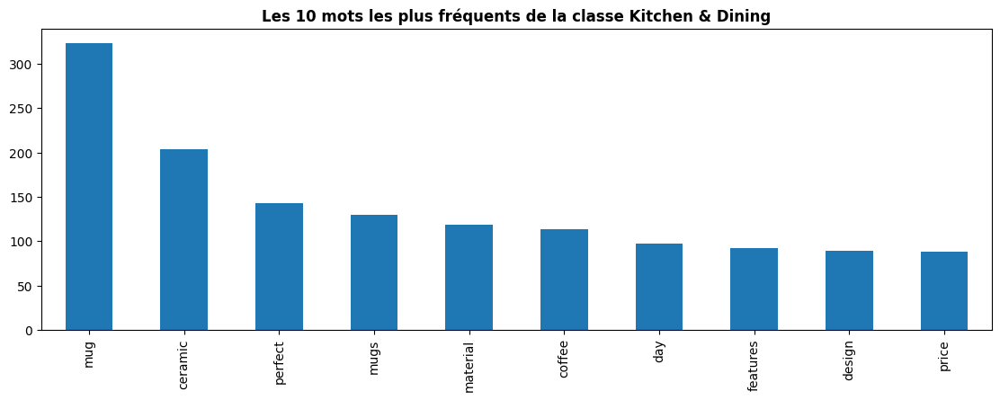

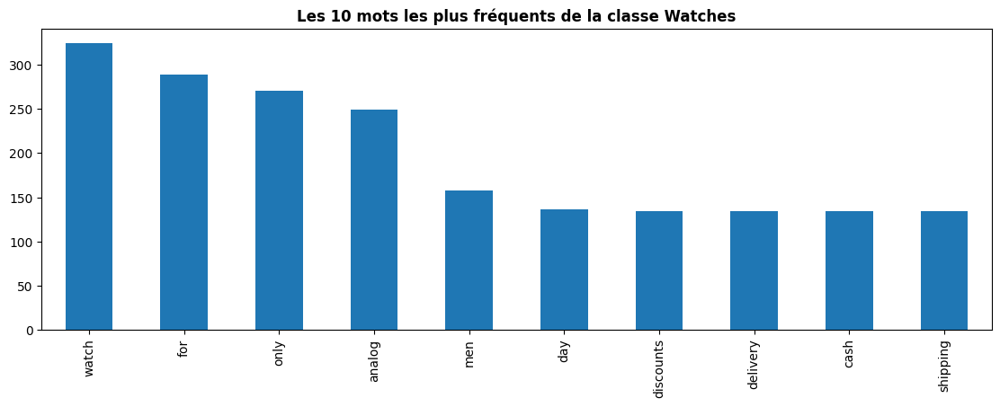

In [65]:
df = data_category.groupby(['cat_1'])['descr_bow'].agg(lambda x : ' '.join(x))

for i in range(df.shape[0]):
    tokens = word_tokenize(df[i])
    # on compte la fréquence de chaque mot 
    freq_desc = pd.Series(FreqDist(tokens))

    fig = plt.figure(figsize=(30,20))
    ax = fig.add_subplot(4,2,i+1)
    freq_desc.sort_values(ascending=False)[0:10].plot.bar(ax=ax)
    ax.set_title("Les 10 mots les plus fréquents de la classe {}".format(df.index[i]), fontweight='bold')
    
plt.show()

On constate que pour certaines catégories, les mots les plus fréquents sont réellement relatifs à cette catégorie. C'est le cas par exemple pour la catégorie Baby Care, avec les mots baby ou cotton, ou encore la catégorie Computers avec laptop, usb ou encore battery. D'autres catégories ont des mots fréquents moins spécifiques, comme pour la catégorie Beauty and Personal Care par exemple.

# **2.3 Méthode Bag of words**

Le bag of words est une méthode de représentation de texte dans le domaine du traitement de texte. Elle consiste à représenter un document ou une phrase sous la forme d'un ensemble de mots, en ignorant l'ordre dans lequel ils apparaissent et en ne prenant en compte que leur fréquence d'apparition.

La manière la plus simple de représenter un document,on a considéré tous les mots utilisés pour chaque artiste, sans distinction ni dépendance par vers, chanson, etc. L'analogie est donc qu'on a considéré chaque artiste par la représentation brute d'un "sac" de tous les mots qu'il a utilisé, sans soucis de contexte (ordre, utilisation, etc).

On peut faire la même chose à l'échelle d'un document qu'on représente par un ensemble des mots qu'il contient. En pratique, ça peut être par exemple un vecteur de fréquence d'apparition des différents mots utilisés (ou stem 😉).

Une représentation bag-of-words classique sera donc celle dans laquelle on représente chaque document par un vecteur de la taille du vocabulaire  |V|
 et on utilisera la matrice composée de l’ensemble de ces N documents qui forment le corpus comme entrée de nos algorithmes.

Paramètres max_df et min_df Prend en argument un float compris dans [0.0, 1.0] ou un int. max_df permet de supprimer les termes de fréquence élevée et min_df permet de supprimer les termes de fréquence faible.

In [66]:
data_category['cat_1'].nunique()

7

Il y a 7 catégories principales. Nous créerons donc 7 clusters lors de notre modélisation.

In [67]:
data_category['cat_1'].unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [68]:
data_category.groupby('label')['cat_1'].max()

label
0                     Baby Care
1      Beauty and Personal Care
2                     Computers
3    Home Decor & Festive Needs
4               Home Furnishing
5              Kitchen & Dining
6                       Watches
Name: cat_1, dtype: object

In [69]:
liste_cat = ['Baby Care','Beauty and Personal Care','Computers','Home Decor & Festive Needs',
            'Home Furnishing','Kitchen & Dining','Watches']

Nous utilisons les descriptions qui ont été mise :
  - en minuscule
  - tokenisation
  - les stopwords ont été retirés
  - lemmatisation et stemmation.


In [70]:
feat = 'name_description_clean' 

In [71]:
data_category.head(3)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3,label,name_description_,name_description_clean,description_clean,descr_bow,length_bow
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains,4,Elegance Polyester Multicolor Abstract Eyelet ...,eleg polyest multicolor abstract eyelet door c...,key featur eleg polyest multicolor abstract ey...,key features elegance polyester multicolor abs...,156
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Sathiyas Cotton Bath Towel Specifications of S...,sathiya cotton bath towel specif sathiya cotto...,specif sathiya cotton bath towel bath towel re...,specifications sathiyas cotton bath towel bath...,63
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Eurospa Cotton Terry Face Towel Set Key Featur...,eurospa cotton terri face towel set key featur...,key featur eurospa cotton terri face towel set...,key features eurospa cotton terry face towel s...,158


In [72]:
data_category.shape

(1050, 14)

# **2.3.1 Méthode CountVectorizer**

CountVectorizer convertit un corpus de documents en une représentation matricielle où
chaque ligne correspond à un document et chaque colonne correspond à un terme unique extrait
de tous les documents. Les valeurs de la matrice indiquent le nombre d'occurrences de chaque
terme dans chaque document. Ainsi, chaque document est représenté par un vecteur de
fréquences de termes.

CountVectorizer transforme chaque document en un vecteur de nombres entiers qui représentent le nombre d'occurrences de chaque mot dans le document.

**min_df, max_df :**
- ils sont utilisés pour contrôler la sélection des mots à inclure dans la matrice de compte de termes générée par CountVectorizer. Ici, cela signifie que les mots présents dans plus de 95% des documents seront ignorés et les mots présents dans moins de 1 document seront ignorés.

- Ces paramètres contrôlent le nombre minimal et le nombre maximal de documents dans lesquels un mot doit apparaître pour être inclus dans les calculs. Les deux paramètres peuvent être exprimés sous forme de nombres réels entre 0 et 1, qui représentent alors des pourcentages de l’ensemble du corpus, ou sous forme de nombres entiers qui représentent des décomptes de documents bruts. 


In [73]:
data_category=data_category.copy()

In [74]:
# création du bag of words (CountVectorizer)
# words that appear in more than 95% of the documents
# should be removed from the vocabulary.
# words that appear in less than 1 of the documents
# should be removed from the vocabulary.
cvect = CountVectorizer(stop_words='english', max_df=0.95, min_df=1)
cv_fit = cvect.fit(data_category['name_description_clean'])
cv_transform= cvect.transform(data_category['name_description_clean']) 

In [75]:
cv_transform

<1050x3667 sparse matrix of type '<class 'numpy.int64'>'
	with 30445 stored elements in Compressed Sparse Row format>

In [76]:
cv_transform.shape

(1050, 3667)

In [77]:
ARI_cv, X_tsne_cv, labels_cv = fcP6.ARI_fct_tsne(cv_transform, liste_cat, data_category["label"])

ARI :  0.4783 time :  7.0


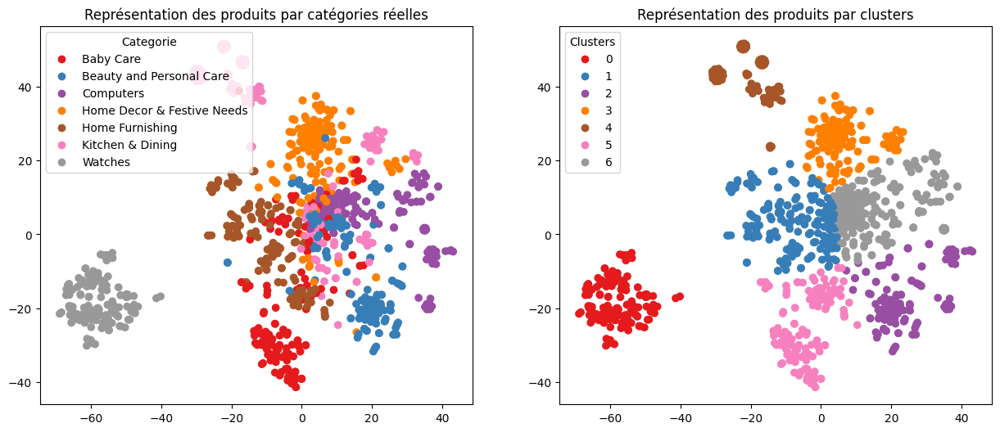

ARI :  0.4783


In [78]:
fcP6.TSNE_visu_fct(X_tsne_cv, liste_cat, data_category["label"], labels_cv, ARI_cv)

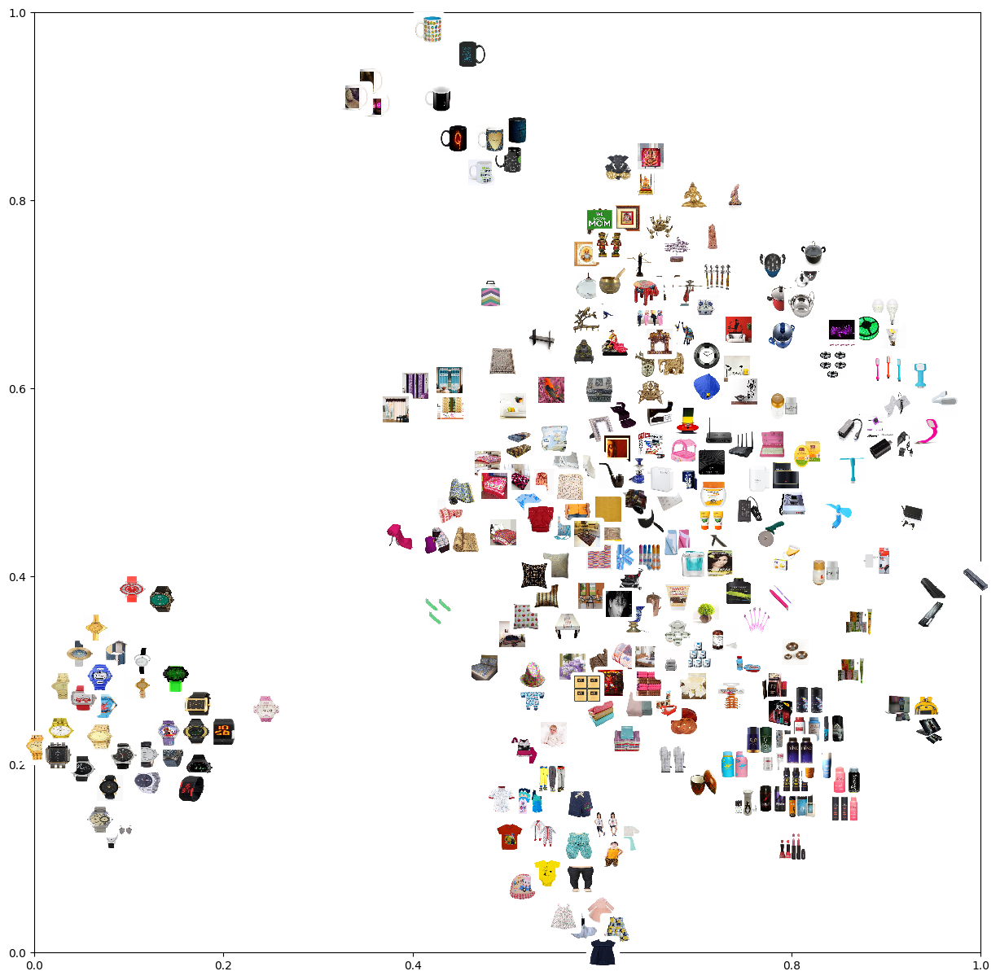

In [79]:
path_images ='C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Ressources/Images/'
fcP6.plot_TSNE_images(X_tsne_cv, data_category, path_images)

# 2.3.1.2 Analyse par classes

In [80]:
conf_mat = metrics.confusion_matrix(data_category["label"], labels_cv)
conf_mat

array([[  0,  22,   5,   1,   1, 103,  18],
       [  0,  17,  89,   4,   0,   2,  38],
       [  0,   3,  37,   0,   0,   0, 110],
       [  0,  21,   4, 103,   0,   1,  21],
       [  0, 117,   0,   0,   0,  33,   0],
       [  0,  11,   6,  21,  79,   6,  27],
       [150,   0,   0,   0,   0,   0,   0]], dtype=int64)

In [81]:
corresp = [0,6,5,3,2,4,1]
cls_labels_transform = fcP6.conf_mat_transform(data_category["label"], labels_cv, corresp)
conf_mat = metrics.confusion_matrix(data_category["label"], cls_labels_transform)
print(conf_mat)
print()
print(metrics.classification_report(data_category["label"], cls_labels_transform))

Correspondance des clusters :  [0, 6, 5, 3, 2, 4, 1]
[[  0  18   1   1 103   5  22]
 [  0  38   0   4   2  89  17]
 [  0 110   0   0   0  37   3]
 [  0  21   0 103   1   4  21]
 [  0   0   0   0  33   0 117]
 [  0  27  79  21   6   6  11]
 [150   0   0   0   0   0   0]]

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       150
           1       0.18      0.25      0.21       150
           2       0.00      0.00      0.00       150
           3       0.80      0.69      0.74       150
           4       0.23      0.22      0.22       150
           5       0.04      0.04      0.04       150
           6       0.00      0.00      0.00       150

    accuracy                           0.17      1050
   macro avg       0.18      0.17      0.17      1050
weighted avg       0.18      0.17      0.17      1050



<Axes: >

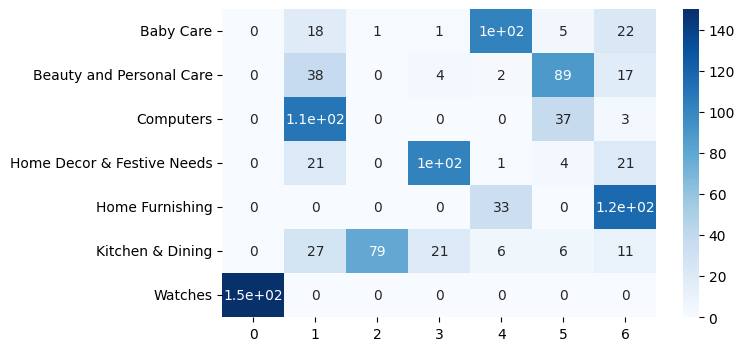

In [82]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in liste_cat],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (7,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")

# 2.3.1.3 La réduction de dimension via LDA

Le modèle Latent Dirichlet Allocation (LDA) est un modèle probabiliste génératif qui permet de décrire des collections de documents de texte ou d’autres types de données discrètes. LDA fait partie d’une catégorie de modèles appelés “topic models”, qui cherchent à découvrir des structures thématiques cachées dans des vastes archives de documents.

Ceci permet d’obtenir des méthodes efficaces pour le traitement et l’organisation des documents de ces archives: organisation automatique des documents par sujet, recherche, compréhension et analyse du texte, ou même résumer des textes.

In [83]:
n_topics = data_category['cat_1'].nunique()

# Créer le modèle LDA
lda = LatentDirichletAllocation(
        n_components=n_topics, 
        learning_method='online', 
        random_state=0)

# Fitter sur les données
lda.fit(cv_transform)

LatentDirichletAllocation(learning_method='online', n_components=7,
                          random_state=0)

In [84]:
no_top_words = 10
fcP6.display_topics(lda, cvect.get_feature_names_out(), no_top_words)

Topic 0:
ship free deliveri genuin cash buy product guarante replac day
Topic 1:
babi cotton print color design girl comfort pack gener fabric
Topic 2:
sticker vinyl wall appli medium larg wallmantra decal skin use
Topic 3:
watch mug analog ceram men woman great towel coffe gift
Topic 4:
home showpiec design box price featur decor inch color materi
Topic 5:
batteri qualiti cell laptop pizza lapguard cutter sstudio high surgic
Topic 6:
laptop skin warranti shape usb pad mous combo print set


# **2.3.2 Méthode Tf-idf**

Tf-idf (ou term frequency-inverse document frequency) est une technique de traitement de texte couramment utilisée pour évaluer l'importance relative d'un terme dans un document. Elle mesure la fréquence d'apparition d'un terme dans un document et l'inverse de la fréquence d'apparition du terme dans tous les documents d'une collection. En d'autres termes, plus un terme apparaît fréquemment dans un document donné et moins il apparaît dans l'ensemble de la collection, plus son poids Tf-idf est élevé.

Tf-idf Vectorizer (Term Frequency-Inverse Document Frequency) est une autre méthode de
vectorisation des données qui prend en compte à la fois la fréquence des termes dans un
document spécifique (fréquence des termes) et leur importance globale dans le corpus
(fréquence inverse du document)

**min_df, max_df :**
- ils sont utilisés pour contrôler la sélection des mots à inclure dans la matrice de compte de termes générée par TfidfVectorizer. Ici, cela signifie que les mots présents dans plus de 95% des documents seront ignorés et les mots présents dans moins de 1 document seront ignorés.

- Ces paramètres contrôlent le nombre minimal et le nombre maximal de documents dans lesquels un mot doit apparaître pour être inclus dans les calculs. Les deux paramètres peuvent être exprimés sous forme de nombres réels entre 0 et 1, qui représentent alors des pourcentages de l’ensemble du corpus, ou sous forme de nombres entiers qui représentent des décomptes de documents bruts. 


In [85]:
data_category=data_category.copy()

In [86]:
tfv = TfidfVectorizer(stop_words='english', max_df=0.95, min_df=1)
tfv_fit = tfv.fit(data_category['name_description_clean'])
tfv_transform = tfv.transform(data_category['name_description_clean'])  

In [87]:
tfv_transform.shape    

(1050, 3667)

In [88]:
tfv_features = tfv_transform.todense()
tfv_features = pd.DataFrame(tfv_features, index=data_category.uniq_id, columns=tfv.get_feature_names_out())
tfv_features.to_csv('df_tfv.csv', index=True)
tfv_features

,aaa,aapno,aari,aarika,abil,abl,abod,abras,abroad,absolut,...,zikrak,zinc,zingalalaa,zip,zipexterior,zipper,zone,zoom,zora,zyxel
uniq_id,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7b72c92c2f6c40268628ec5f14c6d590,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
64d5d4a258243731dc7bbb1eef49ad74,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
d4684dcdc759dd9cdf41504698d737d8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6325b6870c54cd47be6ebfbffa620ec7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
fd6cbcc22efb6b761bd564c28928483c,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5912e037d12774bb73a2048f35a00009,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [89]:
ARI_tfv, X_tsne_tfv, labels_tfv = fcP6.ARI_fct_tsne(tfv_features, liste_cat,data_category["label"])

ARI :  0.557 time :  6.0


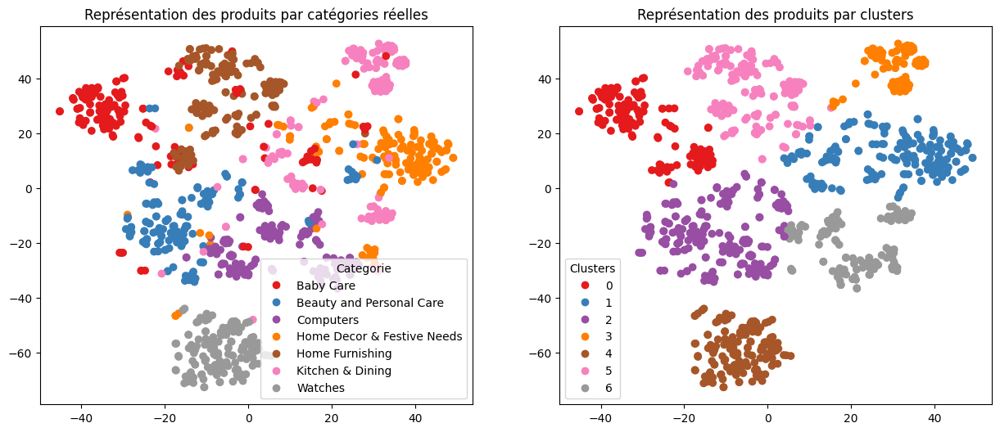

ARI :  0.557


In [90]:
fcP6.TSNE_visu_fct(X_tsne_tfv, liste_cat,data_category["label"], labels_tfv, ARI_tfv)

On obtient une légère amélioration de l'ARI (0.557) après avoir effectué une réduction de dimension via ACP puis une projection TSNE à 2 composantes.

On constate cependant toujours que les clusters ont séparé les différentes catégories de manière plus simplifiée que leur représentation réelle. La plupart des catégories se mélangent plus dans la représentation réelle. D'autres clusters semblent un peu mieux déterminés, ce sont les catégories qui semblent les plus espacées dans la représentation réelle comme Watches.


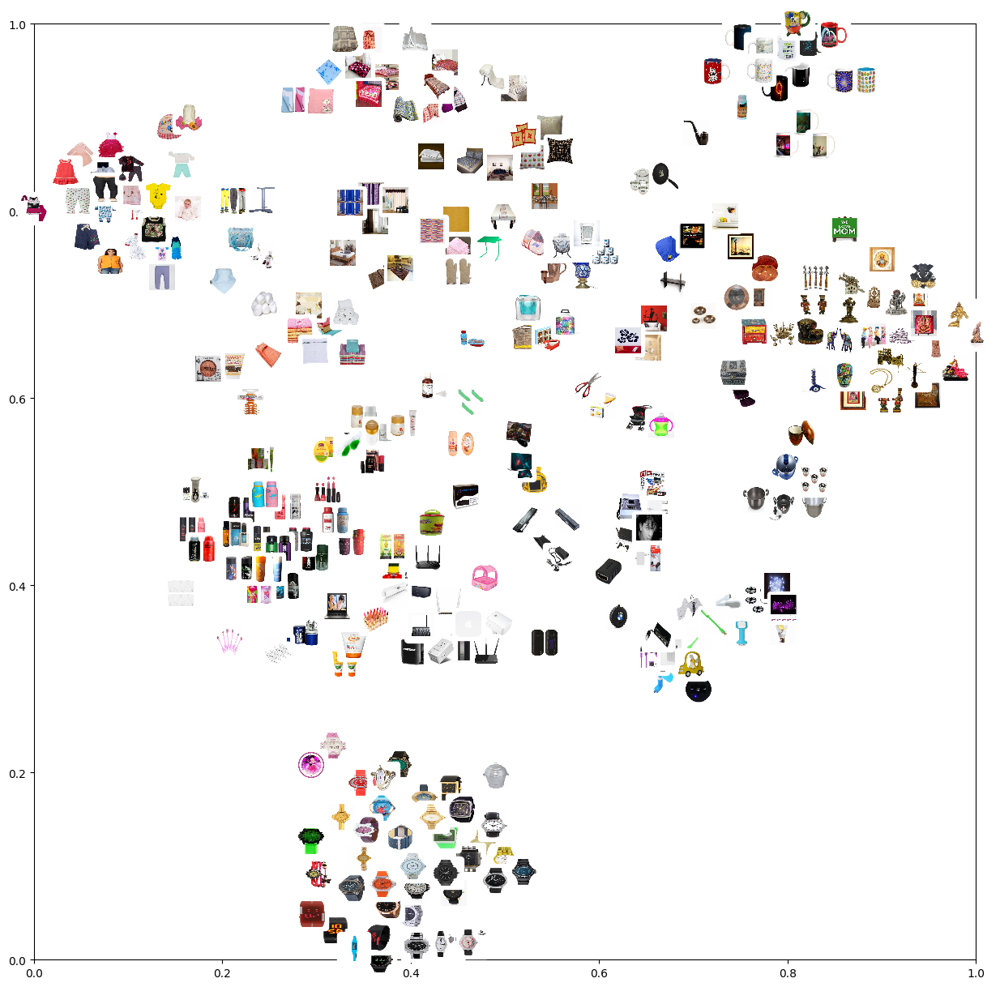

In [91]:
fcP6.plot_TSNE_images(X_tsne_tfv, df_cat, path_images)

On affiche une partie des images sur la visualisation 2D avec les données TSNE calculées précédemment. On constate que certaines catégories sont bien regroupées et séparées à certains endroits. Par exemple, on retouve des montres à droite, des produits pour bébés en haut, du matériel électronique à droite, ainsi que des produits de beauté, et enfin du matériel de cuisine en bas. Au centre, les catégories semblent encore une fois mélangées.

# 2.3.2.2 Analyse par classes

In [92]:
conf_mat = metrics.confusion_matrix(data_category["label"], labels_tfv)
conf_mat

array([[105,  17,  10,   2,   0,  16,   0],
       [ 14,  11, 123,   0,   0,   0,   2],
       [  0,   0,  68,   0,   0,   0,  82],
       [  1, 124,   4,   3,   3,   4,  11],
       [ 19,   1,   0,   0,   0, 130,   0],
       [  1,  29,   5,  77,   1,   8,  29],
       [  0,   0,   0,   0, 150,   0,   0]], dtype=int64)

In [93]:
corresp = [0,6,5,3,2,4,1]
cls_labels_transform = fcP6.conf_mat_transform(data_category["label"], labels_tfv, corresp)
conf_mat = metrics.confusion_matrix(data_category["label"], cls_labels_transform)
print(conf_mat)
print()
print(metrics.classification_report(data_category["label"], cls_labels_transform))

Correspondance des clusters :  [0, 6, 5, 3, 2, 4, 1]
[[105   0   0   2  16  10  17]
 [ 14   2   0   0   0 123  11]
 [  0  82   0   0   0  68   0]
 [  1  11   3   3   4   4 124]
 [ 19   0   0   0 130   0   1]
 [  1  29   1  77   8   5  29]
 [  0   0 150   0   0   0   0]]

              precision    recall  f1-score   support

           0       0.75      0.70      0.72       150
           1       0.02      0.01      0.01       150
           2       0.00      0.00      0.00       150
           3       0.04      0.02      0.03       150
           4       0.82      0.87      0.84       150
           5       0.02      0.03      0.03       150
           6       0.00      0.00      0.00       150

    accuracy                           0.23      1050
   macro avg       0.24      0.23      0.23      1050
weighted avg       0.24      0.23      0.23      1050



<Axes: >

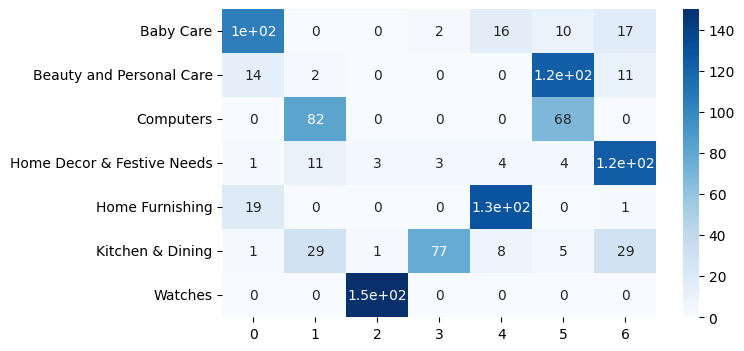

In [94]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in liste_cat],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (7,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")

# 2.3.2.3La réduction de dimension via LDA

Le modèle Latent Dirichlet Allocation (LDA) est un modèle probabiliste génératif qui permet de décrire des collections de documents de texte ou d’autres types de données discrètes. LDA fait partie d’une catégorie de modèles appelés “topic models”, qui cherchent à découvrir des structures thématiques cachées dans des vastes archives de documents.

Ceci permet d’obtenir des méthodes efficaces pour le traitement et l’organisation des documents de ces archives: organisation automatique des documents par sujet, recherche, compréhension et analyse du texte, ou même résumer des textes.

In [95]:
n_topics = data_category['cat_1'].nunique()

# Créer le modèle LDA
lda = LatentDirichletAllocation(
        n_components=n_topics, 
        learning_method='online', 
        random_state=0)

# Fitter sur les données
lda.fit(tfv_transform)

LatentDirichletAllocation(learning_method='online', n_components=7,
                          random_state=0)

In [96]:
no_top_words = 10
fcP6.display_topics(lda, tfv.get_feature_names_out(), no_top_words)

Topic 0:
sticker flipkart showpiec ship genuin cash guarante deliveri replac buy
Topic 1:
babi cotton polyest eyelet girl curtain aroma fabric comfort design
Topic 2:
usb hub port keyboard mobil tablet kliqvik wire devic flexibl
Topic 3:
watch analog mug men laptop woman skin ceram flipkart product
Topic 4:
tabl runner pot yellow bonsai plant seater corkscrew wine prime
Topic 5:
bath towel brush cotton condition mafatl iw brow nkp bornbabykid
Topic 6:
led usb light bulb fan portabl flexibl power bank otg


# **2.4 Word/sentence embedding**

- Le word embedding (plongement de mots) désigne un ensemble de méthode d’apprentissage visant à représenter les mots d’un texte par des vecteurs de nombres réels

# **2.4.1 Word2vec**

-**Word2vec** est un technique de « word embedding » basée sur un algorithme de 
deep learning.

**Word2Vec :** Cet algorithme de word embedding est parmi les plus connus. Il a été développé par une équipe de recherche de Google sous la direction de Tomas Mikolov. Il repose sur des réseaux de neurones à deux couches et cherche à apprendre les représentations vectorielles des mots composant un texte, de telle sorte que les mots qui partagent des contextes similaires soient représentés par des vecteurs numériques proches

In [97]:
data_word2vc=data_category.copy()

In [98]:
data_word2vc.head(3)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3,label,name_description_,name_description_clean,description_clean,descr_bow,length_bow
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains,4,Elegance Polyester Multicolor Abstract Eyelet ...,eleg polyest multicolor abstract eyelet door c...,key featur eleg polyest multicolor abstract ey...,key features elegance polyester multicolor abs...,156
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Sathiyas Cotton Bath Towel Specifications of S...,sathiya cotton bath towel specif sathiya cotto...,specif sathiya cotton bath towel bath towel re...,specifications sathiyas cotton bath towel bath...,63
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Eurospa Cotton Terry Face Towel Set Key Featur...,eurospa cotton terri face towel set key featur...,key featur eurospa cotton terri face towel set...,key features eurospa cotton terry face towel s...,158


In [99]:
data_word2vc.shape

(1050, 14)

In [100]:
y_cat_num = data_word2vc['cat_1']

In [101]:
data_word2vc['cat_1'].value_counts()

cat_1
Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: count, dtype: int64

In [102]:
data_word2vc['cat_1'] = data_word2vc['cat_1'].astype('category')

In [103]:
l_cat = list(data_word2vc['cat_1'].cat.categories)

# 2.4.1.1 Création du modèle Word2Vec

Tout d'abord, un objet Word2Vec est créé en utilisant les hyperparamètres min_count, window, vector_size, seed et workers.
* **min_count** est le nombre minimum de fois qu'un mot doit apparaître dans le corpus pour être pris en compte dans le modèle.
* **window** est la taille de la fenêtre de contexte autour de chaque mot.
* **vector_size** est la dimensionnalité de l'espace vectoriel dans lequel les mots sont représentés.
* **seed** est une valeur utilisée pour initialiser les poids du modèle, garantissant ainsi que le modèle sera initialisé de la même manière à chaque fois qu'il est exécuté.
* **workers** est le nombre de threads utilisés pour l'entraînement du modèle.

Ensuite, le vocabulaire est construit en utilisant la méthode **build_vocab**, qui prend en entrée une liste de phrases (ou de tokens).

Le modèle est ensuite entraîné en utilisant la méthode train, qui prend en entrée les mêmes phrases et les hyperparamètres total_examples et epochs.
* **total_examples** est le nombre total de phrases dans le corpus.
* **epochs** est le nombre de fois que le modèle parcourt tout le corpus lors de l'entraînement.

Enfin, les vecteurs de mots du modèle sont extraits en utilisant l'attribut wv, et les mots correspondant à ces vecteurs sont extraits en utilisant l'attribut index_to_key. La taille du vocabulaire est également imprimée à la fin de l'exécution du code.

In [104]:
w2v_size = 300  # Dimensionality of the feature vectors. - (50, 300)
w2v_window = 15  # The maximum distance between the current and predicted word within a sentence.
w2v_min_count = 5  # Ignores all words with total absolute frequency lower than this - (2, 100)
w2v_epochs = 30  # Number of iterations (epochs) over the corpus - [10, 20, 30]
maxlen = None  # adapt to length of sentences
sentences =  data_word2vc['name_description_clean'].to_list() 
sentences = [gensim.utils.simple_preprocess(text) for text in sentences]

In [105]:
# Création et entraînement du modèle Word2Vec

print("Build & train Word2Vec model ...")
w2v_model = gensim.models.Word2Vec(min_count=w2v_min_count,
                                   window=w2v_window,
                                   vector_size=w2v_size,
                                   seed=42,
                                   workers=1)                             
w2v_model.build_vocab(sentences)

w2v_model.train(sentences,
                total_examples=w2v_model.corpus_count,
                epochs=w2v_epochs)

model_vectors = w2v_model.wv
w2v_words = model_vectors.index_to_key
print("Vocabulary size: %i" % len(w2v_words))
print("Word2Vec trained")

Build & train Word2Vec model ...
Vocabulary size: 1470
Word2Vec trained


Tout d'abord, un objet Tokenizer est créé en utilisant la bibliothèque Keras.

La méthode **fit_on_texts** est utilisée pour ajuster le tokenizer aux phrases d'entraînement. Cela permet au tokenizer de construire un dictionnaire de tous les mots dans les phrases d'entraînement, ainsi que de leur fréquence d'apparition.

Ensuite, les phrases sont converties en séquences de nombres entiers en utilisant la méthode **texts_to_sequences** du tokenizer. Cela remplace chaque mot dans la phrase par son index dans le dictionnaire construit à l'étape précédente.

Les séquences de nombres entiers sont ensuite remplies avec des zéros ou tronquées pour avoir la même longueur en utilisant la fonction **pad_sequences** de Keras. Cela permet d'avoir des entrées de taille fixe pour l'entraînement du modèle.

La variable num_words est ensuite définie comme étant le nombre total de mots uniques dans le dictionnaire, en ajoutant 1 pour inclure un token réservé pour les mots inconnus.

Enfin, la taille du vocabulaire est imprimée à la fin de l'exécution du code.

In [106]:
# Préparation des sentences (tokenization)

print("Fit Tokenizer ...")
tokenizer = Tokenizer()
tokenizer.fit_on_texts(sentences)
x_sentences = pad_sequences(tokenizer.texts_to_sequences(sentences),
                            maxlen=maxlen,
                            padding='post') 
                                                   
num_words = len(tokenizer.word_index) + 1
print("Number of unique words: %i" % num_words)

Fit Tokenizer ...
Number of unique words: 3748


In [107]:
x_sentences.shape

(1050, 348)

# 2.4.1.2 Création de la matrice d'embedding



Pour chaque mot dans le dictionnaire, une recherche est effectuée pour voir si l'embedding pour ce mot existe dans le modèle Word2Vec entraîné précédemment. Si oui, l'embedding correspondant est ajouté à la matrice d'embedding à la position de l'index du mot dans le dictionnaire.

Enfin, la proportion de mots dans le vocabulaire qui ont un embedding est calculée et affichée, ainsi que la forme de la matrice d'embedding.


In [108]:
# Création de la matrice d'embedding

print("Create Embedding matrix ...")
w2v_size = 300
word_index = tokenizer.word_index
vocab_size = len(word_index) + 1
embedding_matrix = np.zeros((vocab_size, w2v_size))
i=0
j=0
    
for word, idx in word_index.items():
    i +=1
    if word in w2v_words:
        j +=1
        embedding_vector = model_vectors[word]
        if embedding_vector is not None:
            embedding_matrix[idx] = model_vectors[word]
            
word_rate = np.round(j/i,4)
print("Word embedding rate : ", word_rate)
print("Embedding matrix: %s" % str(embedding_matrix.shape))

Create Embedding matrix ...
Word embedding rate :  0.3923
Embedding matrix: (3748, 300)


# 2.4.1.3 Création du modèle d'embedding

Tout d'abord, une couche d'entrée est créée avec une forme correspondant à la forme de x_sentences.

Ensuite, une autre couche d'entrée est créée pour les mots individuels dans chaque phrase, avec une forme correspondant à la longueur maximale de chaque phrase (maxlen).

Une couche d'embedding est créée en utilisant les poids de la matrice d'embedding créée précédemment, avec l'input_dim défini comme la taille du vocabulaire, output_dim défini comme la taille de l'embedding (w2v_size), et input_length défini comme la longueur maximale de chaque phrase (maxlen).

Une couche de Global Average Pooling est ajoutée pour calculer la moyenne des embeddings des mots dans chaque phrase.

Un modèle d'embedding est créé en utilisant les entrées pour les mots individuels et la sortie de la couche de Global Average Pooling.

Enfin, un résumé du modèle est affiché.

Le modèle d'embedding ainsi créé peut être utilisé comme base pour construire un modèle de classification ou de régression en ajoutant d'autres couches de neurones après la couche de Global Average Pooling.


In [109]:
# Création du modèle
input=Input(shape=(len(x_sentences),maxlen),dtype='float64')

word_input=Input(shape=(maxlen,),dtype='float64')  

word_embedding=Embedding(input_dim=vocab_size,
                         output_dim=w2v_size,
                         weights = [embedding_matrix],
                         input_length=maxlen)(word_input)
word_vec=GlobalAveragePooling1D()(word_embedding)  
embed_model = Model([word_input],word_vec)

embed_model.summary()


Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None)]            0         
                                                                 
 embedding (Embedding)       (None, None, 300)         1124400   
                                                                 
 global_average_pooling1d (  (None, 300)               0         
 GlobalAveragePooling1D)                                         
                                                                 
Total params: 1124400 (4.29 MB)
Trainable params: 1124400 (4.29 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [110]:
embeddings = embed_model.predict(x_sentences)
embeddings.shape

33/33 [==============================] - 0s 3ms/step


(1050, 300)

In [111]:
w2v_features = pd.DataFrame(embeddings, index=data_word2vc.uniq_id)
w2v_features.to_csv('df_w2v.csv')
w2v_features

,0,1,2,3,4,5,6,7,8,9,...,290,291,292,293,294,295,296,297,298,299
uniq_id,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7,-0.030332,-0.047048,-0.089967,-0.050919,-0.115042,0.069351,0.016970,0.075530,0.154919,-0.225390,...,-0.229448,0.184069,0.004699,-0.119195,-0.022641,-0.067039,-0.076566,0.018663,-0.003931,0.088230
7b72c92c2f6c40268628ec5f14c6d590,-0.022522,0.005618,-0.058704,-0.032653,-0.062099,-0.058979,0.003494,-0.033004,0.116333,-0.127324,...,-0.161954,0.026336,-0.043587,0.012693,0.094895,-0.028220,-0.012012,0.045031,0.041723,-0.051967
64d5d4a258243731dc7bbb1eef49ad74,0.000694,0.006011,-0.049204,-0.018080,-0.126553,-0.076992,-0.064994,0.033379,0.191161,-0.265848,...,-0.269327,0.104826,-0.078243,0.046660,0.255664,0.026498,0.007900,-0.049953,-0.053356,-0.101479
d4684dcdc759dd9cdf41504698d737d8,-0.151231,0.012264,-0.086655,-0.037405,-0.078521,-0.006443,0.194305,0.046019,0.107883,-0.364010,...,-0.276369,0.036545,0.031370,0.206751,0.261430,0.032822,0.011287,0.029446,0.052564,0.075541
6325b6870c54cd47be6ebfbffa620ec7,-0.163796,0.020771,-0.124383,-0.035109,-0.104896,0.055936,0.180743,0.087476,0.156607,-0.423998,...,-0.313511,0.109725,0.028424,0.292380,0.348549,0.090146,0.005840,-0.012634,-0.001275,0.107655
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc,0.121424,-0.111143,-0.012380,-0.132846,-0.168425,0.104826,0.130901,0.000031,-0.122451,0.093493,...,0.038645,0.378762,-0.070231,-0.028159,0.045387,0.211457,0.164447,0.207639,-0.052975,0.052664
fd6cbcc22efb6b761bd564c28928483c,0.076399,-0.069503,-0.042489,-0.068276,-0.064975,0.112700,0.063926,0.067773,-0.056967,-0.011615,...,-0.028758,0.336589,-0.025464,-0.056823,0.031058,0.103229,0.051506,0.086958,-0.084273,0.111491
5912e037d12774bb73a2048f35a00009,0.017698,0.009074,-0.024350,-0.010069,-0.000478,-0.003428,0.018513,0.009857,-0.025408,-0.002145,...,-0.014231,0.054008,-0.003019,-0.061109,0.022115,0.001735,0.033709,0.015026,0.027658,-0.013717


In [112]:
w2v_features = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_w2v.csv')
w2v_features.drop(columns=['uniq_id'], inplace=True)

In [113]:
ARI_w2v, X_tsne_w2v, labels_w2v = fcP6.ARI_fct(w2v_features, y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 300)
Dimensions dataset après réduction PCA :  (1050, 30)
ARI :  0.3863 time :  4.0


In [114]:
l_w2v = pd.Series(labels_w2v).map(
    {0: 0, 1: 3, 2: 6, 3: 2, 4: 5, 5: 4, 6: 1}).values

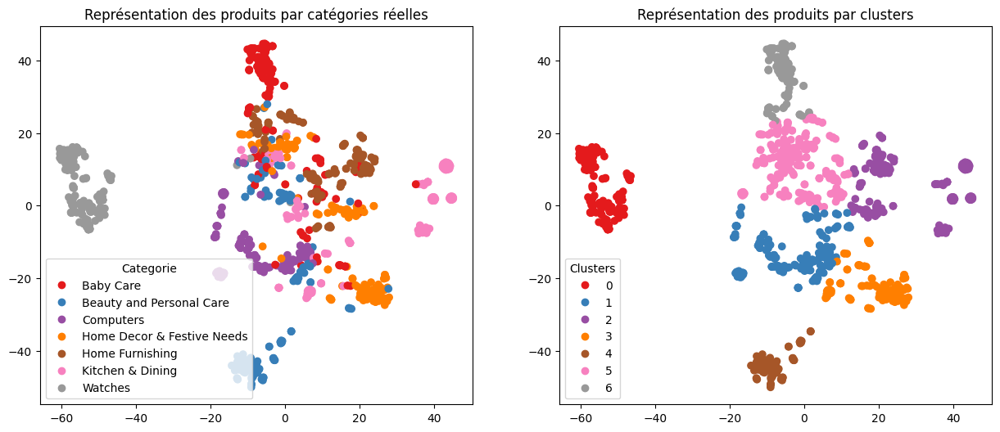

ARI :  0.3863


In [115]:
fcP6.TSNE_visu_fct(X_tsne_w2v,l_cat,data_category["label"],l_w2v,ARI_w2v)

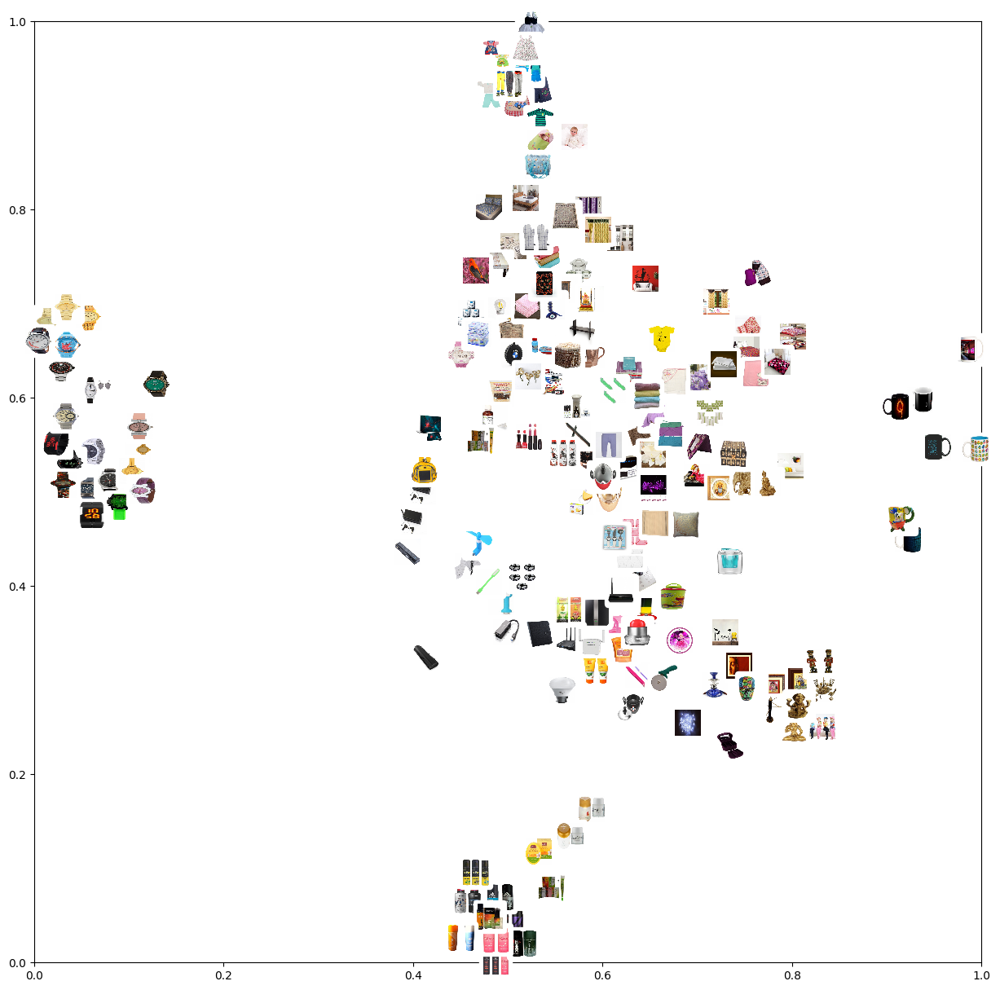

In [116]:
fcP6.plot_TSNE_images(X_tsne_w2v, data_category, path_images)

# **2.4.2 BERT**

BERT (Bidirectional Encoder Representations from Transformers) est un modèle de
langage pré-entraîné qui aide à comprendre le sens des mots dans une phrase en analysant leur
contexte. Il a été développé par Google et est largement utilisé dans le traitement du langage
naturel. BERT utilise une architecture spéciale appelée transformer, qui lui permet de capturer
les informations à la fois avant et après chaque mot, ce qui lui donne une bonne compréhension
du texte. Grâce à son entraînement sur de grandes quantités de données, BERT peut fournir des
représentations de mots riches en informations, ce qui est utile pour des tâches comme la
classification de texte, la génération de texte et les questions-réponses

BERT de base est constitué de 12 couches d'attention. Chaque couche d'attention permet au
modèle de comprendre les relations entre les mots à différentes distances dans la séquence.
Chaque couche est composée de plusieurs têtes d'attention, qui se concentrent sur différentes
parties de la séquence lors de la représentation des mots. Les couches d'attention successives
améliorent progressivement la compréhension du modèle et extraient des représentations de
mots de plus en plus informatives. Il existe des variantes de BERT avec un nombre différent de
couches, comme BERT-large avec 24 couches, qui offrent des capacités de représentation plus
puissantes mais nécessitent plus de ressources de calcul

BERT est capable de comprendre le contexte bidirectionnel du langage. Il prend donc en compte à la fois les mots précédents et les mots suivants dans une phrase. Cela lui permet de mieux comprendre le sens des mots et des phrases.

In [117]:
print(tf.__version__)
print(tensorflow.__version__)
print("Num CPUs Available: ", len(tf.config.experimental.list_physical_devices('CPU')))
print(tf.test.is_built_with_cuda())

2.15.0
2.15.0
Num CPUs Available:  1
False


In [118]:
data_BERT=data_category.copy()
data_BERT.head(3)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3,label,name_description_,name_description_clean,description_clean,descr_bow,length_bow
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains,4,Elegance Polyester Multicolor Abstract Eyelet ...,eleg polyest multicolor abstract eyelet door c...,key featur eleg polyest multicolor abstract ey...,key features elegance polyester multicolor abs...,156
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Sathiyas Cotton Bath Towel Specifications of S...,sathiya cotton bath towel specif sathiya cotto...,specif sathiya cotton bath towel bath towel re...,specifications sathiyas cotton bath towel bath...,63
2,64d5d4a258243731dc7bbb1eef49ad74,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Eurospa Cotton Terry Face Towel Set Key Featur...,eurospa cotton terri face towel set key featur...,key featur eurospa cotton terri face towel set...,key features eurospa cotton terry face towel s...,158


In [119]:
y_cat_num = data_BERT["cat_1"]

In [120]:
y_cat_num 

0       Home Furnishing
1             Baby Care
2             Baby Care
3       Home Furnishing
4       Home Furnishing
             ...       
1045          Baby Care
1046          Baby Care
1047          Baby Care
1048          Baby Care
1049          Baby Care
Name: cat_1, Length: 1050, dtype: object

data_BERT['cat_1'] = data_BERT['cat_1'].astype('category')
l_cat = list(data_BERT['cat_1'].cat.categories)

In [121]:
l_cat 

['Baby Care',
 'Beauty and Personal Care',
 'Computers',
 'Home Decor & Festive Needs',
 'Home Furnishing',
 'Kitchen & Dining',
 'Watches']

# 2.4.2.1 BERT HuggingFace: 'bert-base-uncased'

- max_length : il s'agit de la longueur maximale (en nombre de tokens) des séquences de texte qui seront utilisées comme entrée pour le modèle. Si une séquence est plus longue que max_length, elle sera tronquée, et si elle est plus courte, elle sera remplie avec des tokens spéciaux (généralement des zéros). max_length est définie à 296 qui correspond à la plus longue phrase dans notre corpus.
 - batch_size : il s'agit du nombre d'exemples d'entraînement qui sont traités en même temps par le modèle lors de l'entraînement. Dans cet exemple, batch_size est défini à 10.
 - model_type : il s'agit du type de modèle pré-entraîné qui sera utilisé pour l'entraînement. Dans notre cas, le modèle BERT pré-entraîné est utilisé, avec la configuration bert-base-uncased. Il s'agit d'une version de BERT qui utilise un vocabulaire de 30 000 mots, avec des lettres en minuscule et sans accentuation. Ensuite, la variable sentences est définie en récupérant les données pré-traitées de la colonne "name_description_clean" de l'objet data.



In [122]:
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = TFAutoModel.from_pretrained(model_type) 
sentences = data_BERT['name_description_clean'].to_list() 

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.dense.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions w

- mode : il s'agit du mode d'extraction de features. Dans ce cas, il est défini à 'HF', ce qui signifie que la fonction utilise l'interface Hugging Face de TensorFlow pour extraire les features. La fonction feature_BERT_fct doit renvoyer deux valeurs :
 - features_bert : il s'agit d'un tableau numpy qui contient les features BERT extraits pour chaque séquence de texte dans sentences.
- last_hidden_states_tot : il s'agit d'un tableau numpy qui contient les états cachés de la dernière couche du modèle BERT pour chaque séquence de texte dans sentences. Ces états cachés peuvent être utilisés pour d'autres tâches, telles que la classification de texte ou la génération de texte.



In [123]:
# Création des features
features_bert, last_hidden_states_tot = fcP6.feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='HF')

1/1 [==============================] - 0s 334ms/step
temps traitement :  52.0


In [124]:
beart_hf_features = pd.DataFrame(features_bert, index=data_BERT.uniq_id)
beart_hf_features.to_csv('df_beat_hf.csv', index=True)
beart_hf_features

,0,1,2,3,4,5,6,7,8,9,...,758,759,760,761,762,763,764,765,766,767
uniq_id,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7,0.138652,-0.051538,0.784252,-0.023162,0.412471,0.274690,-0.005024,0.129945,-0.126157,-0.382554,...,0.079191,-0.279003,0.213820,0.159966,0.105177,0.127500,-0.360797,0.145839,-0.030441,-0.002423
7b72c92c2f6c40268628ec5f14c6d590,0.181446,-0.181196,0.352714,-0.030234,0.082951,0.087923,0.227339,0.036935,0.011648,-0.072786,...,-0.105556,-0.075497,0.124812,-0.042338,0.100101,0.029512,-0.488499,-0.291209,-0.038832,0.100726
64d5d4a258243731dc7bbb1eef49ad74,0.101216,-0.215071,0.615027,-0.006666,0.403367,0.079230,-0.159205,0.164316,0.130466,-0.324253,...,-0.138310,-0.217991,0.093211,-0.047210,0.084845,0.101279,-0.351405,-0.219155,-0.235183,0.099062
d4684dcdc759dd9cdf41504698d737d8,0.064819,0.012836,0.590212,0.084654,0.456409,-0.351679,-0.178890,0.213869,-0.094434,0.056963,...,-0.073983,-0.035350,0.160877,-0.237297,-0.128346,0.014398,-0.366294,-0.030499,0.091707,-0.277255
6325b6870c54cd47be6ebfbffa620ec7,0.087196,0.109249,0.693429,-0.036576,0.465192,-0.361935,-0.116173,0.297417,0.115454,-0.027253,...,0.075510,-0.161053,0.161832,-0.104769,-0.219701,0.222375,-0.537670,-0.111130,0.160206,-0.363443
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc,-0.281526,-0.217732,0.544512,-0.085545,0.174960,-0.012873,-0.025851,0.060691,0.097716,-0.294776,...,-0.147055,-0.300124,0.144183,0.137753,0.152805,-0.032076,-0.431666,-0.257461,-0.081731,-0.096286
fd6cbcc22efb6b761bd564c28928483c,-0.157256,-0.097322,0.873481,0.021908,0.514487,-0.087468,-0.191848,-0.003809,0.127732,-0.433334,...,0.168269,-0.231152,0.165479,-0.046440,0.244073,-0.005931,-0.510530,-0.051785,-0.045538,-0.241594
5912e037d12774bb73a2048f35a00009,-0.005610,-0.267452,0.591749,0.113959,0.314784,0.002909,-0.212887,0.333804,-0.176472,-0.090305,...,-0.247644,-0.283824,0.022487,0.052833,0.058135,0.197391,-0.501576,-0.035224,-0.093960,-0.174176


In [125]:
beart_hf_features = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_beat_hf.csv')
beart_hf_features.drop(columns=['uniq_id'], inplace=True)

In [126]:
ARI_bert, X_tsne_bert, labels_bert = fcP6.ARI_fct(beart_hf_features, y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 768)
Dimensions dataset après réduction PCA :  (1050, 339)
ARI :  0.3993 time :  7.0


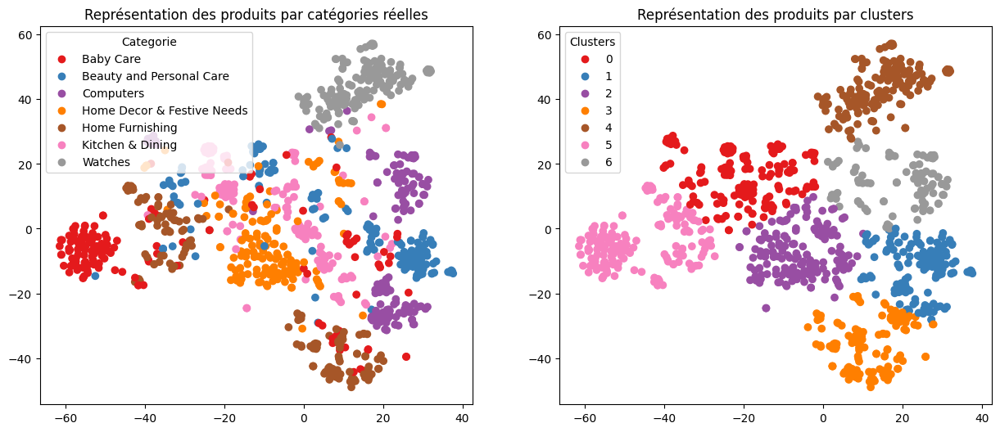

ARI :  0.3993


In [127]:
l_bert = pd.Series(labels_bert).map(
    {0: 5, 1: 6, 2: 2, 3: 0, 4: 4, 5: 3, 6: 1}).values
fcP6.TSNE_visu_fct(X_tsne_bert,l_cat,data_category["label"],l_bert,ARI_bert)

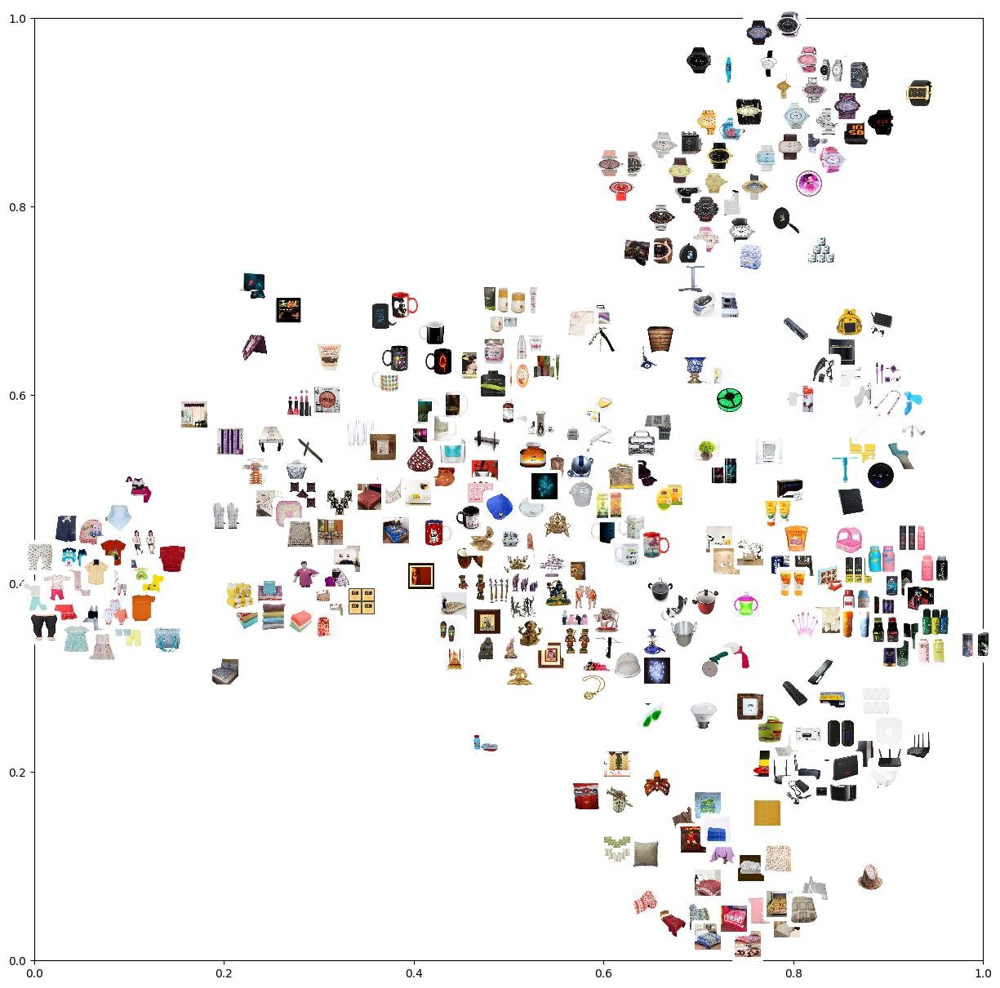

In [128]:
fcP6.plot_TSNE_images(X_tsne_bert, data_category, path_images)

# 2.4.2.2 BERT hub Tensorflow

Une couche de prétraitement BERT est chargée depuis Tensorflow Hub à partir de l'URL model_url. Cette couche est ensuite utilisée pour créer un modèle de classification de texte.

La couche de prétraitement BERT permet de transformer les phrases en une représentation vectorielle dense qui peut être utilisée en entrée d'un modèle de classification ou d'un modèle de régression. Cette couche a été entraînée sur une grande quantité de données textuelles et est capable de capturer les nuances sémantiques et syntaxiques des phrases. Le paramètre trainable=True signifie que les poids de la couche BERT peuvent être ajustés pendant l'apprentissage du modèle.


In [129]:
model_url = 'https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4'
bert_layer = hub.KerasLayer(model_url, trainable=True)

In [130]:
sentences = data_BERT['name_description_clean'].to_list()
max_length = 64
batch_size = 10
model_type = 'bert-base-uncased'
model = bert_layer

features_bert, last_hidden_states_tot = fcP6.feature_BERT_fct(model, model_type, sentences, 
                                                         max_length, batch_size, mode='TFhub')

temps traitement :  44.0


In [131]:
beart_ht_features = pd.DataFrame(features_bert, index=data_BERT.uniq_id)
beart_ht_features.to_csv('df_beat_ht.csv', index=True)
beart_ht_features

,0,1,2,3,4,5,6,7,8,9,...,758,759,760,761,762,763,764,765,766,767
uniq_id,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7,0.137289,-0.050926,0.782590,-0.024115,0.410912,0.273706,-0.005542,0.129376,-0.125021,-0.383251,...,0.078749,-0.277932,0.214163,0.159174,0.104001,0.125485,-0.360636,0.146908,-0.028872,0.000290
7b72c92c2f6c40268628ec5f14c6d590,0.180954,-0.179457,0.350506,-0.030111,0.082296,0.088365,0.225322,0.035504,0.011731,-0.073502,...,-0.105862,-0.074689,0.125917,-0.043418,0.099093,0.027646,-0.489227,-0.290892,-0.038540,0.102999
64d5d4a258243731dc7bbb1eef49ad74,0.100548,-0.214871,0.613297,-0.006844,0.403021,0.079106,-0.161306,0.163863,0.130683,-0.324700,...,-0.138131,-0.217784,0.094056,-0.046640,0.083793,0.099814,-0.350562,-0.218578,-0.235254,0.101221
d4684dcdc759dd9cdf41504698d737d8,0.064515,0.013845,0.588042,0.084601,0.455134,-0.351436,-0.179468,0.213570,-0.093179,0.056830,...,-0.074614,-0.035027,0.161315,-0.237847,-0.128703,0.012360,-0.365677,-0.030119,0.092062,-0.273216
6325b6870c54cd47be6ebfbffa620ec7,0.086569,0.109882,0.690962,-0.037441,0.463378,-0.361685,-0.117240,0.296711,0.116338,-0.027736,...,0.074928,-0.160333,0.162301,-0.105149,-0.220103,0.221386,-0.537931,-0.109955,0.160482,-0.359829
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc,-0.282114,-0.216700,0.542716,-0.086881,0.174051,-0.013646,-0.027471,0.061097,0.098810,-0.295691,...,-0.147367,-0.300606,0.145317,0.138390,0.151642,-0.033622,-0.430775,-0.258355,-0.081539,-0.093695
fd6cbcc22efb6b761bd564c28928483c,-0.157378,-0.097017,0.871495,0.021035,0.513401,-0.087699,-0.194020,-0.004066,0.128201,-0.433395,...,0.166761,-0.230981,0.166537,-0.046535,0.242547,-0.008262,-0.510688,-0.051455,-0.045449,-0.238440
5912e037d12774bb73a2048f35a00009,-0.007413,-0.266803,0.590372,0.113107,0.312809,0.001825,-0.213666,0.332891,-0.175553,-0.090881,...,-0.248843,-0.284335,0.023558,0.052999,0.057693,0.195288,-0.502017,-0.035379,-0.093615,-0.172712


In [132]:
beart_ht_features = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_beat_ht.csv')
beart_ht_features.drop(columns=['uniq_id'], inplace=True)

In [133]:
ARI_Bhub, X_tsne_Bhub, labels_Bhub = fcP6.ARI_fct(beart_ht_features, y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 768)
Dimensions dataset après réduction PCA :  (1050, 339)
ARI :  0.4177 time :  8.0


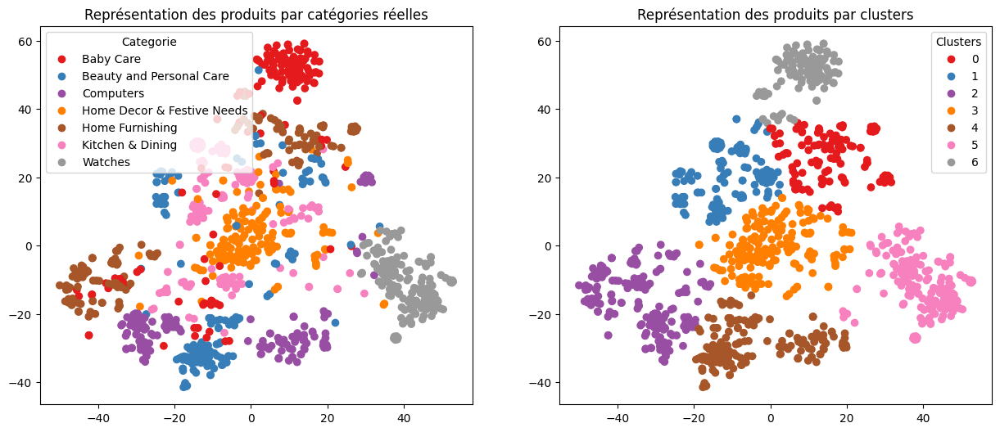

ARI :  0.4177


In [134]:
l_Bhub = pd.Series(labels_Bhub).map(
    {0: 1, 1: 3, 2: 6, 3: 4, 4: 5, 5: 0, 6: 2}).values
fcP6.TSNE_visu_fct(X_tsne_Bhub,l_cat,data_category["label"],l_Bhub,ARI_Bhub)


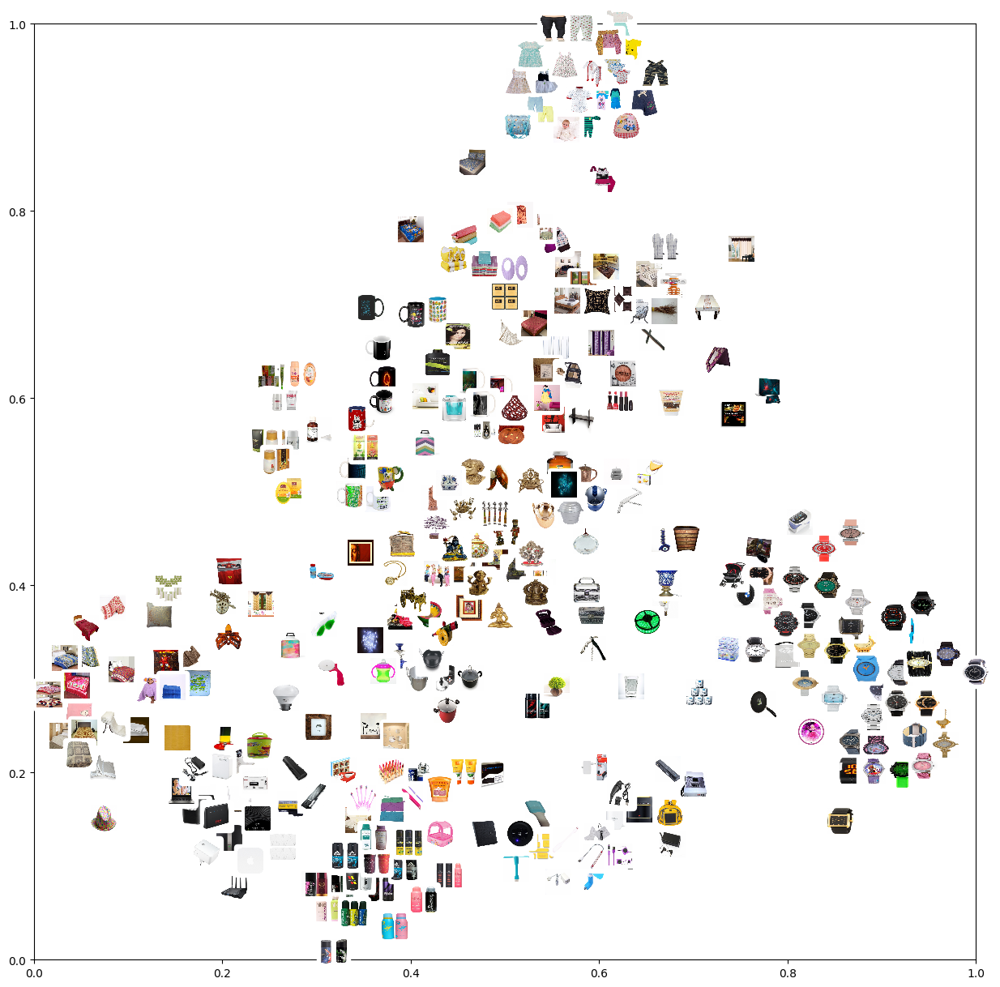

In [135]:
fcP6.plot_TSNE_images(X_tsne_Bhub, data_category, path_images)

# **2.4.3 USE - Universal Sentence Encoder**

USE (Universal Sentence Encoder) est un modèle de traitement du langage naturel développé par Google. Il permet de convertir des phrases en vecteurs de nombre réels, également appelés embeddings, qui capturent le sens sémantique de la phrase. Le modèle est entraîné sur un grand corpus de texte en plusieurs langues et est capable de comprendre les nuances sémantiques et contextuelles des phrases dans différentes langues.

In [136]:
data_use=data_category.copy()

In [137]:
data_use.head(2)

,uniq_id,product_name,product_category_tree,image,description,cat_1,cat_2,cat_3,label,name_description_,name_description_clean,description_clean,descr_bow,length_bow
0,55b85ea15a1536d46b7190ad6fff8ce7,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,Home Furnishing,Curtains & Accessories,Curtains,4,Elegance Polyester Multicolor Abstract Eyelet ...,eleg polyest multicolor abstract eyelet door c...,key featur eleg polyest multicolor abstract ey...,key features elegance polyester multicolor abs...,156
1,7b72c92c2f6c40268628ec5f14c6d590,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,Baby Care,Baby Bath & Skin,Baby Bath Towels,0,Sathiyas Cotton Bath Towel Specifications of S...,sathiya cotton bath towel specif sathiya cotto...,specif sathiya cotton bath towel bath towel re...,specifications sathiyas cotton bath towel bath...,63


In [138]:
y_cat_num = data_use["cat_1"]
data_use['cat_1'] = data_use['cat_1'].astype('category')
l_cat = list(data_use['cat_1'].cat.categories)

# 2.4.3.1 USE 'description_clean'

In [139]:
batch_size = 10
sentences_1 = data_use['description_clean'].to_list()

In [140]:
features_USE_1 = fcP6.feature_USE_fct(sentences_1, batch_size)

In [141]:
features_USE_1.shape

(1050, 512)

In [142]:
# enregistrement des features textuelles
df_use_1_ = pd.DataFrame(features_USE_1, index=data_use.uniq_id)
df_use_1 = df_use_1_.reset_index()
df_use_1.to_csv('df_use.csv', index=False)

In [143]:
df_use_1.head(2)

,uniq_id,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
0,55b85ea15a1536d46b7190ad6fff8ce7,-0.056739,-0.055940,0.014060,0.045568,-0.042843,-0.002536,-0.004045,0.049962,-0.049600,...,0.040711,-0.058111,-0.057560,0.052078,-0.032536,-0.035824,0.008249,-0.032590,0.019609,-0.050899
1,7b72c92c2f6c40268628ec5f14c6d590,-0.047911,-0.040252,-0.000566,0.025167,0.043211,0.060539,0.050069,-0.019619,-0.000804,...,0.034115,-0.059891,-0.052918,-0.044679,-0.032329,-0.054751,-0.037034,0.013644,0.002407,-0.016178


In [144]:
features_USE_dl = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_use.csv')
features_USE_dl.drop(columns=['uniq_id'], inplace=True)

In [145]:
ARI_USE_1, X_tsne_USE_1, labels_USE_1 = fcP6.ARI_fct(features_USE_dl,  y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 512)
Dimensions dataset après réduction PCA :  (1050, 311)
ARI :  0.4032 time :  7.0


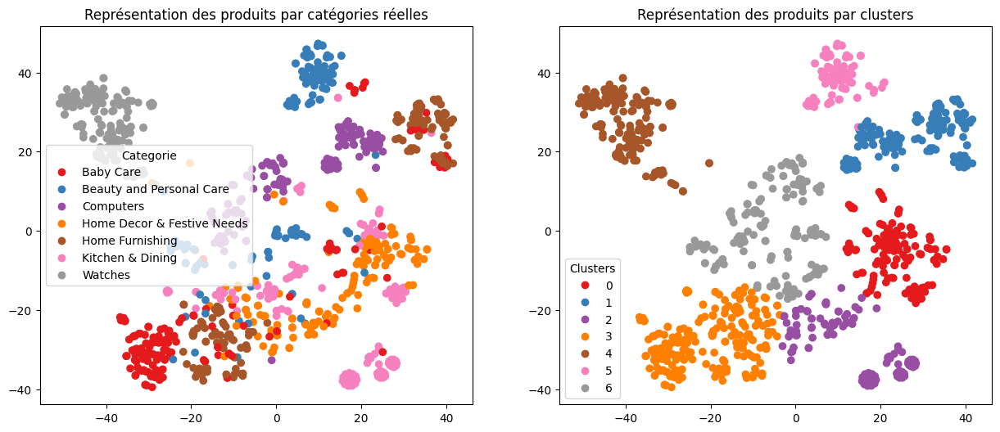

ARI :  0.4032


In [146]:
l_USE_1 = pd.Series(labels_USE_1).map(
    {0: 3, 1: 1, 2: 6, 3: 4, 4: 2, 5: 0, 6: 5}).values
fcP6.TSNE_visu_fct(X_tsne_USE_1,l_cat,data_category["label"],l_USE_1,ARI_USE_1)  

In [147]:
X_tsne_USE_1.shape

(1050, 2)

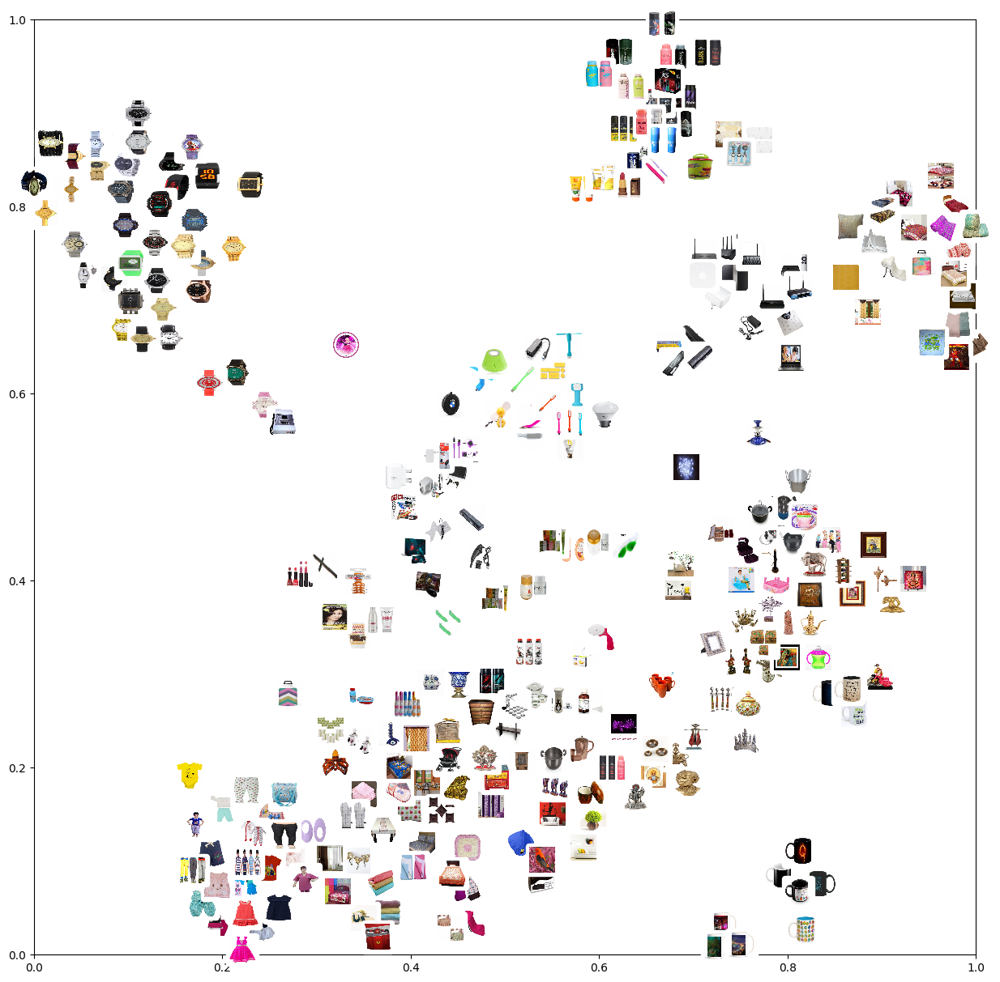

In [148]:
fcP6.plot_TSNE_images(X_tsne_USE_1, data_category, path_images)

# 2.4.3.2 USE 'product_name'

In [149]:
batch_size = 10
sentences_2 = data_use['product_name'].to_list()

In [150]:
features_USE_name = fcP6.feature_USE_fct(sentences_2, batch_size)

In [151]:
# enregistrement des features textuelles
df_use_2_ = pd.DataFrame(features_USE_name, index=data_use.uniq_id)
df_use_name = df_use_2_.reset_index()
df_use_name.to_csv('df_use_name.csv', index=False)

In [152]:
df_use_name.head(2)

,uniq_id,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
0,55b85ea15a1536d46b7190ad6fff8ce7,0.056465,-0.016699,-0.037086,0.043791,0.002945,0.067963,-0.016188,0.046416,0.033914,...,-0.057716,-0.015941,-0.017477,0.069993,0.053311,-0.006422,0.019230,-0.013060,0.049839,0.063842
1,7b72c92c2f6c40268628ec5f14c6d590,0.005994,0.054335,-0.008692,0.028411,0.077500,0.083581,0.034467,-0.015866,-0.013572,...,0.064480,-0.043876,-0.055092,-0.053607,-0.018392,-0.045410,-0.046664,-0.002589,0.068149,0.025688


In [153]:
features_USE_name = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_use_name.csv')
features_USE_name.drop(columns=['uniq_id'], inplace=True)

In [154]:
ARI_USE_2, X_tsne_USE_2, labels_USE_2 = fcP6.ARI_fct(features_USE_name,  y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 512)
Dimensions dataset après réduction PCA :  (1050, 303)
ARI :  0.6809 time :  7.0


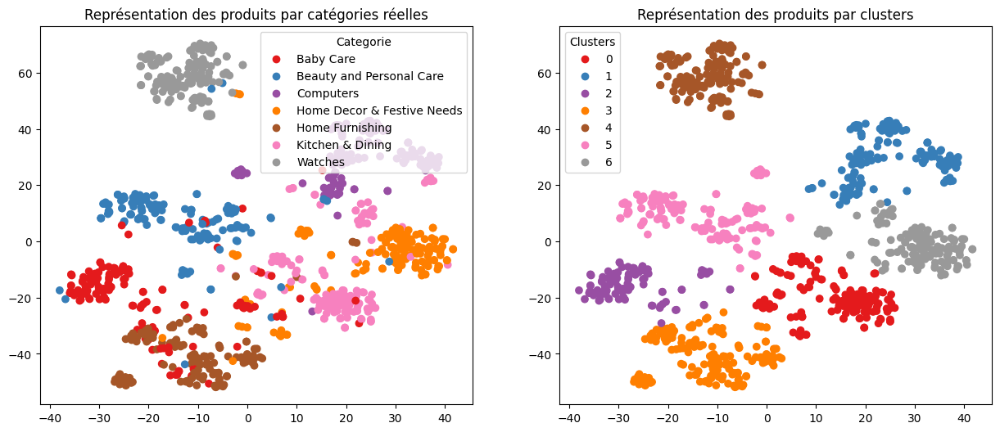

ARI :  0.6809


In [155]:
l_USE_2 = pd.Series(labels_USE_2).map(
    {0: 3, 1: 1, 2: 6, 3: 4, 4: 2, 5: 0, 6: 5}).values
fcP6.TSNE_visu_fct(X_tsne_USE_2,l_cat,data_category["label"],l_USE_2,ARI_USE_2) 

In [156]:
X_tsne_USE_2.shape

(1050, 2)

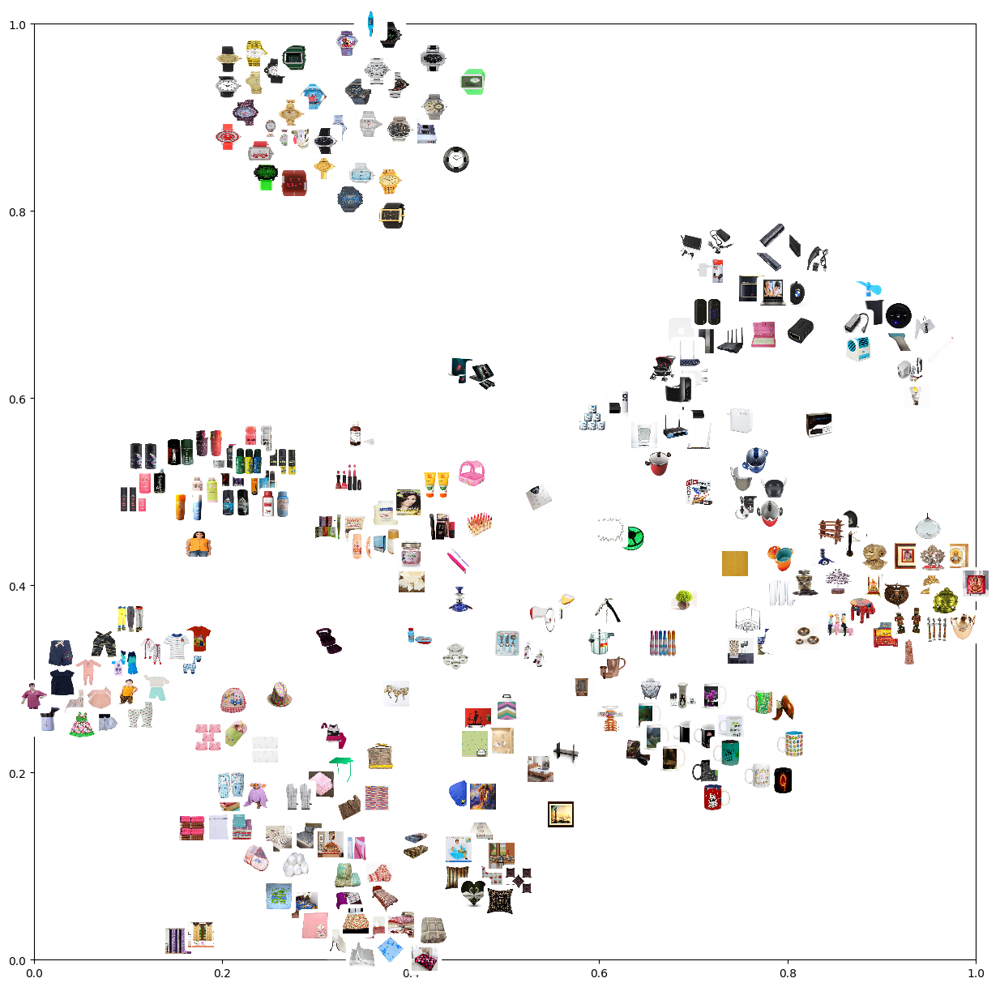

In [157]:
fcP6.plot_TSNE_images(X_tsne_USE_2, data_category, path_images)

# 2.4.3.3 USE 'name_description_clean'

In [158]:
batch_size = 10
sentences_3 = data_use['name_description_clean'].to_list()

In [159]:
features_USE_ls = fcP6.feature_USE_fct(sentences_3, batch_size)

In [160]:
# enregistrement des features textuelles
df_use_3_ = pd.DataFrame(features_USE_ls, index=data_use.uniq_id)
df_use_ls = df_use_3_.reset_index()
df_use_ls.to_csv('df_use_ls.csv', index=False)

In [161]:
df_use_ls.head(2)

,uniq_id,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
0,55b85ea15a1536d46b7190ad6fff8ce7,-0.055759,-0.055663,0.010810,0.045898,-0.039956,-0.001957,-0.002629,0.050240,-0.049525,...,0.041139,-0.057241,-0.056861,0.053926,-0.030036,-0.041588,0.008676,-0.034019,0.013919,-0.049675
1,7b72c92c2f6c40268628ec5f14c6d590,-0.045187,-0.033806,0.000573,0.031983,0.045092,0.059043,0.048874,-0.022709,-0.020216,...,0.042770,-0.058738,-0.055372,-0.049442,-0.038401,-0.055885,-0.036253,0.021763,-0.003800,-0.018752


In [162]:
features_USE_ls = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_use_ls.csv')
features_USE_ls.drop(columns=['uniq_id'], inplace=True)

In [163]:
ARI_USE_3, X_tsne_USE_3, labels_USE_3 = fcP6.ARI_fct(features_USE_ls,  y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 512)
Dimensions dataset après réduction PCA :  (1050, 337)
ARI :  0.3746 time :  8.0


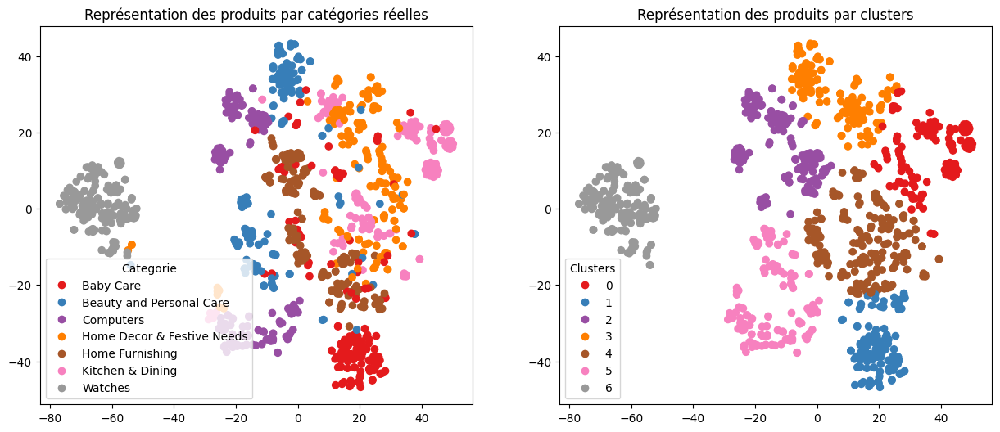

ARI :  0.3746


In [164]:
l_USE_3 = pd.Series(labels_USE_3).map(
    {0: 3, 1: 1, 2: 6, 3: 4, 4: 2, 5: 0, 6: 5}).values
fcP6.TSNE_visu_fct(X_tsne_USE_3,l_cat,data_category["label"],l_USE_3,ARI_USE_3) 

In [165]:
X_tsne_USE_3.shape

(1050, 2)

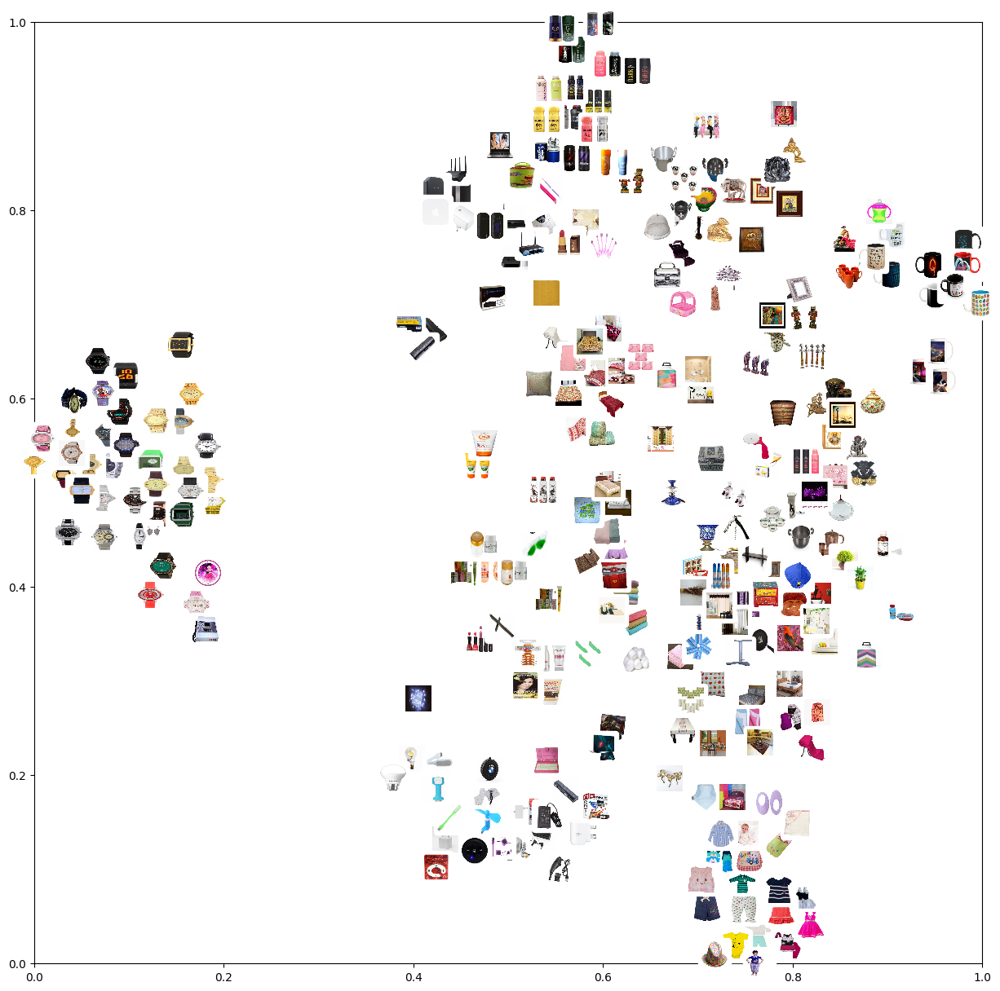

In [166]:
fcP6.plot_TSNE_images(X_tsne_USE_3, data_category, path_images)

# 2.4.3.4 USE 'name_description_'

In [167]:
batch_size = 10
sentences_4 = data_use['name_description_'].to_list()

In [168]:
features_USE_nm = fcP6.feature_USE_fct(sentences_4, batch_size)

In [169]:
# enregistrement des features textuelles
df_use_4_ = pd.DataFrame(features_USE_nm, index=data_use.uniq_id)
df_use_nm = df_use_4_.reset_index()
df_use_nm.to_csv('df_use_name_desc.csv', index=False)

In [170]:
df_use_nm.head(2)

,uniq_id,0,1,2,3,4,5,6,7,8,...,502,503,504,505,506,507,508,509,510,511
0,55b85ea15a1536d46b7190ad6fff8ce7,-0.055534,-0.020297,0.018365,0.045050,0.027716,0.052597,-0.050475,0.056851,-0.024169,...,-0.048252,-0.058649,-0.055747,0.051122,-0.007967,-0.045255,0.026859,0.051097,0.046685,-0.016535
1,7b72c92c2f6c40268628ec5f14c6d590,-0.049757,-0.022721,0.015772,0.026302,0.057145,0.058875,0.056576,-0.024019,-0.048798,...,0.034672,-0.058676,-0.055957,-0.055825,-0.024039,-0.052942,-0.011828,0.034628,0.035242,0.031800


In [171]:
features_USE_nm = pd.read_csv('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Code/df_use_name_desc.csv')
features_USE_nm.drop(columns=['uniq_id'], inplace=True)

In [172]:
ARI_USE_4, X_tsne_USE_4, labels_USE_4 = fcP6.ARI_fct(features_USE_nm,  y_cat_num)

Dimensions dataset avant réduction PCA :  (1050, 512)
Dimensions dataset après réduction PCA :  (1050, 339)
ARI :  0.4699 time :  7.0


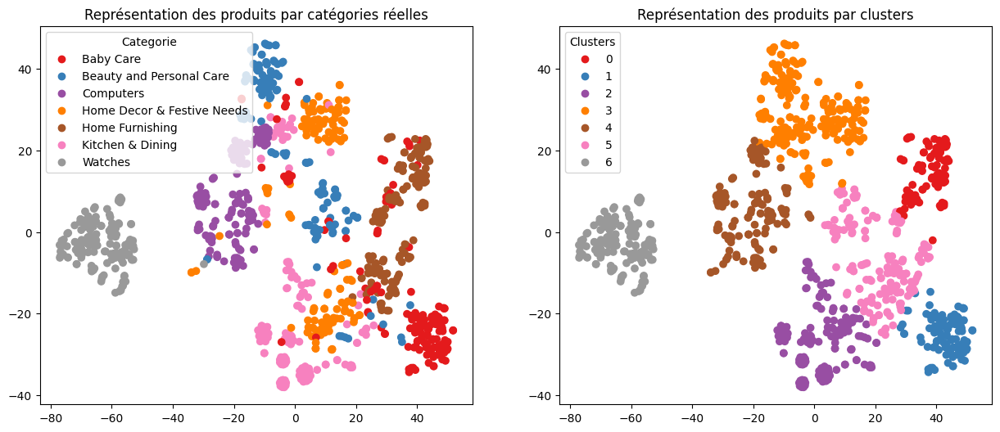

ARI :  0.4699


In [174]:
l_USE_4 = pd.Series(labels_USE_4).map(
    {0: 3, 1: 1, 2: 6, 3: 4, 4: 2, 5: 0, 6: 5}).values
fcP6.TSNE_visu_fct(X_tsne_USE_4,l_cat,data_category["label"],l_USE_4,ARI_USE_4) 

In [175]:
X_tsne_USE_4.shape

(1050, 2)

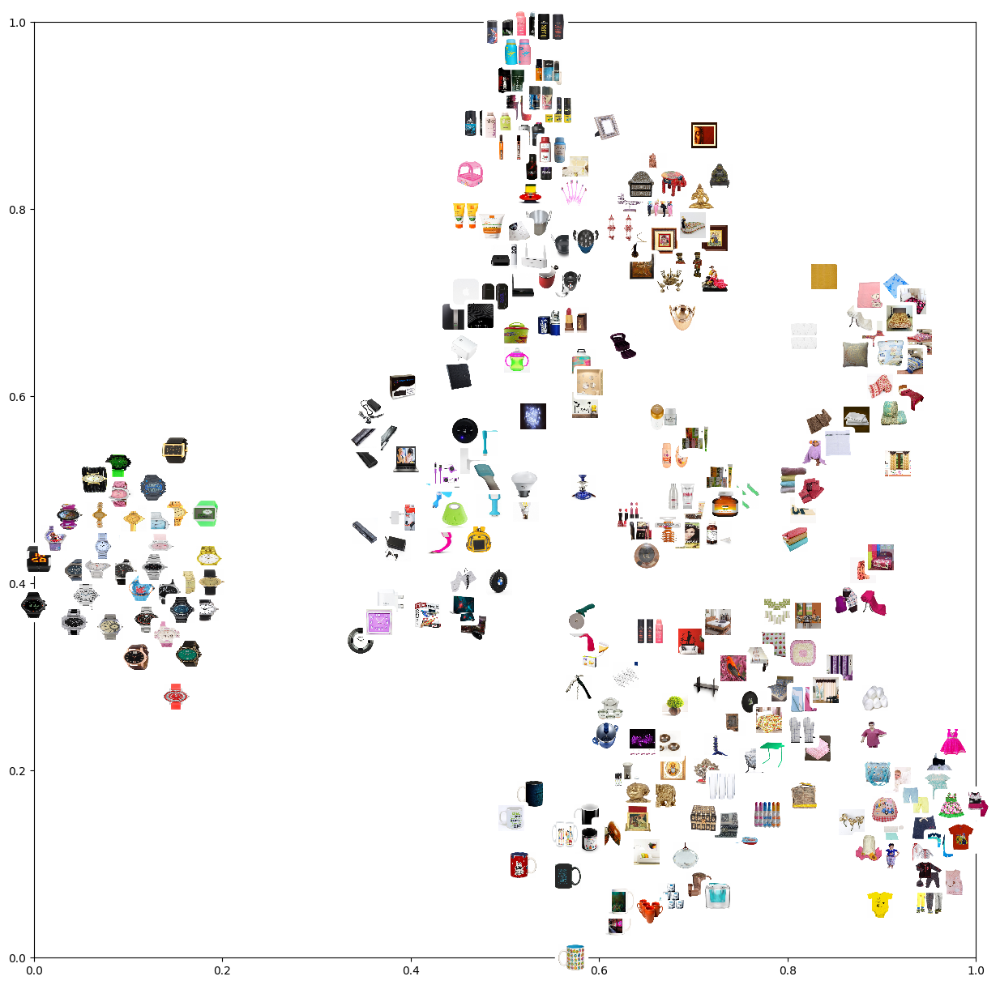

In [176]:
fcP6.plot_TSNE_images(X_tsne_USE_4, data_category, path_images)

# 2.7 **Conclusion**

 - **Etude de faisabilité via les données textuelles:**
L'analyse graphique montre visuellement qu'il est réalisable de séparer automatiquement les produits selon leurs vraies catégorie. Ceci suffit à démontrer la faisabilité de réaliser ultérieurement une classification supervisée pour déterminer automatiquement les catégories des produits.
- Plusieurs approches ont été testées, les meilleurs résultats sont obtenus par le modèle **TF_idf** sur les noms des produits. On obtient un ARI de **0.5570**


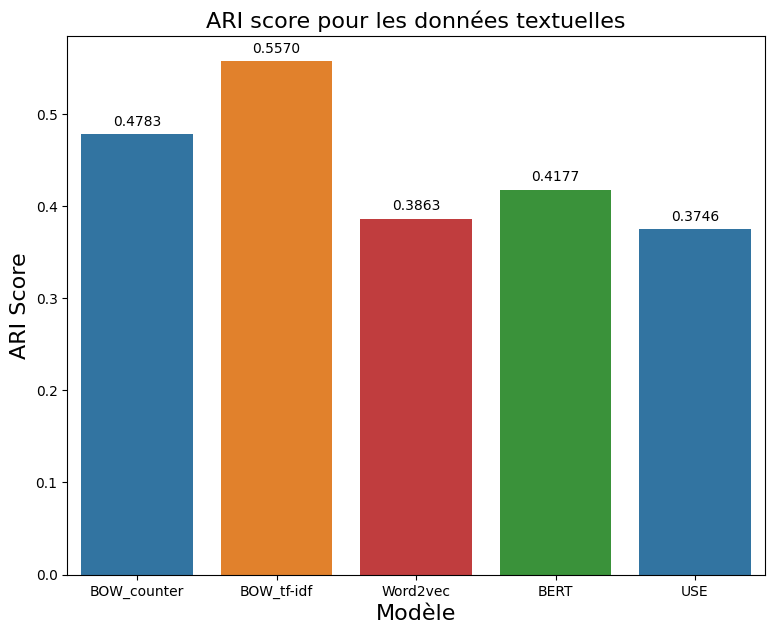

In [238]:
model_ = ['BOW_counter', 'BOW_tf-idf', 'Word2vec', 'BERT', 'USE']
ari_ = [0.4783, 0.5570, 0.3863, 0.4177, 0.3746]
colors = ['blue','red','yellow','orange','green']
dataf = pd.DataFrame({"model_":model_, "ari_":ari_})
plt.figure(figsize = (9, 7))
splot = sns.barplot(x = "model_", y = "ari_", data=dataf,color = 'blue',
                    palette = ['tab:blue', 'tab:orange', 'tab:red', 'tab:green'])


for g in splot.patches:
    splot.annotate(format(g.get_height(), '.4f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 9),
                   textcoords = 'offset points')
    
plt.xlabel("Modèle",fontsize=16)
plt.ylabel("ARI Score",fontsize=16)
plt.title('ARI score pour les données textuelles', fontsize=16)
plt.show()
plt.show()

# **Partie 3 :Traitement des données visuelles**

In [178]:
df_text_clean.shape

(1050, 12)

In [179]:
path_images ='C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Ressources/Images/'
list_photos = [file for file in listdir(path_images)]
print(len(list_photos))

1050


In [180]:
df_cat =df_text_clean.copy()

In [181]:
data = df_text_clean.loc[:, ['uniq_id',
                               'image',
                               'cat_1',
                               'label']]

In [182]:
#data_categories_image = data
#data_categories_image.to_csv('data_categories_image.csv', index=True)
#data = data_categories_image.copy()
#data.head()

In [183]:
data = data.rename(columns={"image": "image_path",
                            "cat_1": "label_name"})

data_categories_image = data
data_categories_image.to_csv('data_categories_image.csv', index=True)
data = data_categories_image.copy()
data.head()

,uniq_id,image_path,label_name,label
0,55b85ea15a1536d46b7190ad6fff8ce7,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,0
3,d4684dcdc759dd9cdf41504698d737d8,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,4


In [184]:
data_categories_image.to_csv('data_categories_image.csv', index=True)

In [185]:
data["image_path"] = data["image_path"].apply(lambda x : path_images + x)
athir=data.copy()

In [186]:
data.head()

,uniq_id,image_path,label_name,label
0,55b85ea15a1536d46b7190ad6fff8ce7,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Baby Care,0
3,d4684dcdc759dd9cdf41504698d737d8,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Home Furnishing,4
4,6325b6870c54cd47be6ebfbffa620ec7,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Home Furnishing,4


In [187]:
data.groupby("label").count()

,uniq_id,image_path,label_name
label,,,
0,150,150,150
1,150,150,150
2,150,150,150
3,150,150,150
4,150,150,150
5,150,150,150
6,150,150,150


In [188]:
set(data.label_name)

{'Baby Care',
 'Beauty and Personal Care',
 'Computers',
 'Home Decor & Festive Needs',
 'Home Furnishing',
 'Kitchen & Dining',
 'Watches'}

In [189]:
data['label_name'] = data['label_name'].astype('category')
list_labels = list(data['label_name'].cat.categories)
list_labels

['Baby Care',
 'Beauty and Personal Care',
 'Computers',
 'Home Decor & Festive Needs',
 'Home Furnishing',
 'Kitchen & Dining',
 'Watches']

In [190]:
# revoie la liste des images dans la catégorie name
def list_fct(name) :
    list_image_name = list(data.loc[data["label_name"]==name, "image_path"])
    return list_image_name

In [191]:
name = 'Baby Care'
filename = np.random.choice(list_fct(name), 1)[0]
filename

'C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Ressources/Images/38782cce965307ddcdbedfcb7fa409c3.jpg'

Baby Care


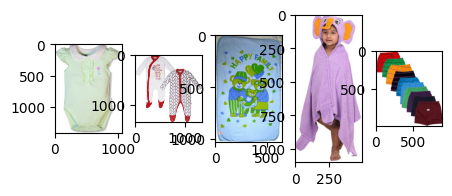

Beauty and Personal Care


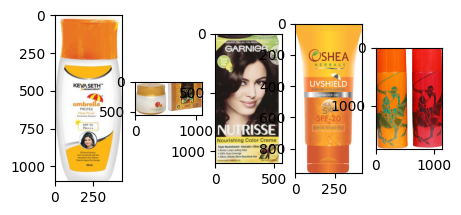

Computers


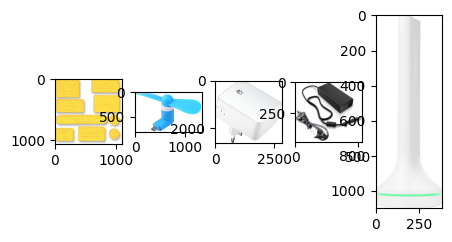

Home Decor & Festive Needs


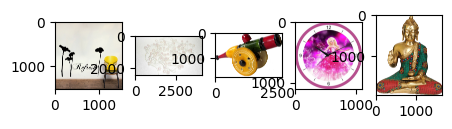

Home Furnishing


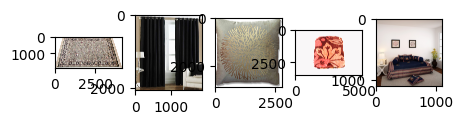

Kitchen & Dining


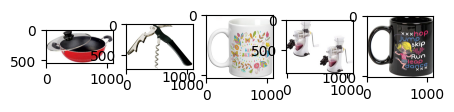

Watches


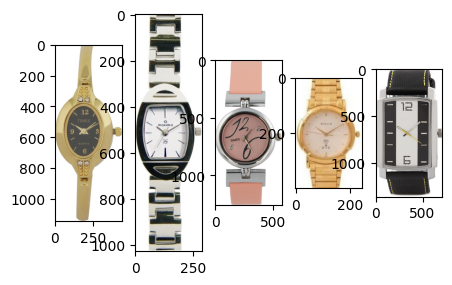

In [192]:
for name in list_labels :
    plt.figure(figsize=(5, 5))
    print(name)
    # print("-------")
    for i in range(5):
        plt.subplot(150 + 1 + i)
        filename = np.random.choice(list_fct(name), 1)[0]
        image = imread(filename)
        plt.imshow(image)
    plt.show()

In [193]:
data.head(3)

,uniq_id,image_path,label_name,label
0,55b85ea15a1536d46b7190ad6fff8ce7,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Home Furnishing,4
1,7b72c92c2f6c40268628ec5f14c6d590,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Baby Care,0
2,64d5d4a258243731dc7bbb1eef49ad74,C:/Users/misso/Desktop/Formation_DS_23_24_MERA...,Baby Care,0


In [194]:
athir1=data.copy()

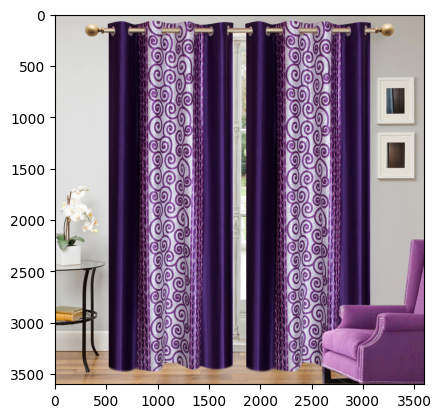

In [195]:
image_test_path = data.image_path[0] 
image_test = imread(image_test_path)
plt.imshow(image_test)
plt.show()

# 3.1 Transformation des images

# 3.1.1 Exemple 1

On effectue et affiche plusieurs transformations sur les images : un passage en gris, l'égalisation des histogrammes et l'élimination du bruit.

In [196]:
# Image initiale
image1 = cv2.imread(path_images+list_photos[1])

# Image convertie en gris
image2 = cv2.imread(path_images+list_photos[1],0)

# Image égalisée
image3 = cv2.equalizeHist(image2)

# Image débruitée
image4 = cv2.GaussianBlur(image3, (5, 5), 0)

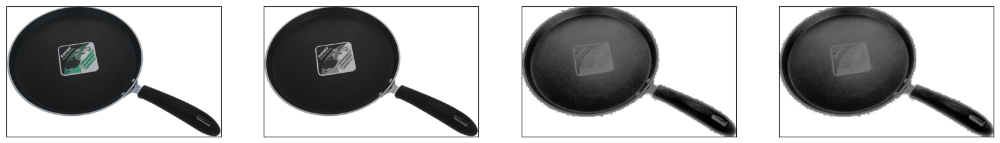

In [197]:
fcP6.display([image1,image2,image3, image4],5)

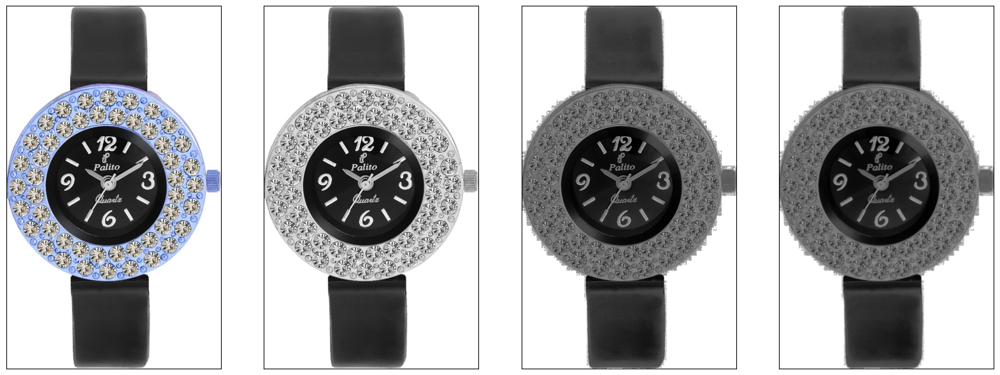

In [198]:
# Image initiale
image1 = cv2.imread(path_images+list_photos[0])

# Image convertie en gris
image2 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)

# Image égalisée

image3 = cv2.equalizeHist(image2)
image4 = cv2.GaussianBlur(image3, (5, 5), 0)

fcP6.display([image1,image2,image3, image4],5)

# 3.1.2 Exemple 2

 # 3.1.2.1 Illustration du pré-traitement sur une image

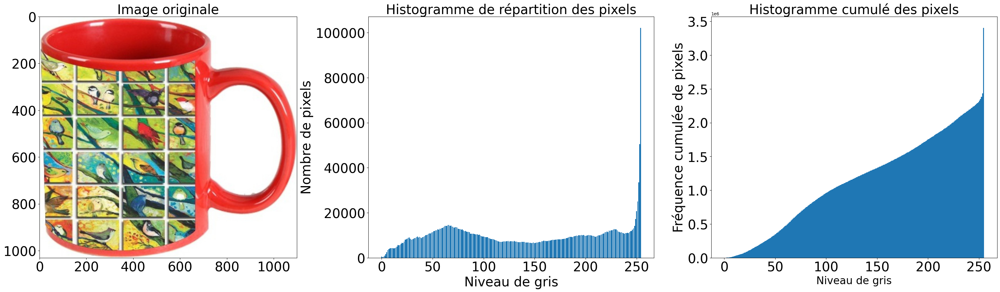

In [199]:
# Chargement de l'image originale comme matrice de pixels
img_orig = Image.open('C:/Users/misso/Desktop/Formation_DS_23_24_MERAH/2-Projet/6- Projet 6/Ressources/Images/3c4ca34c50a5437a1bcc42b72fc1351f.jpg')
fcP6.afficher_image_histopixel(img_orig, 'Image originale')

# 3.1.2.2 Correction de l'exposition (étirement d'histogramme)

 - Image sous-exposée ==> histogramme concentré à droite vers les niveaux de gris faible (255 = blanc).
 - Image sur-exposée ==> histogramme concentré à gauche vers les niveaux de gris fort (0 = noir).



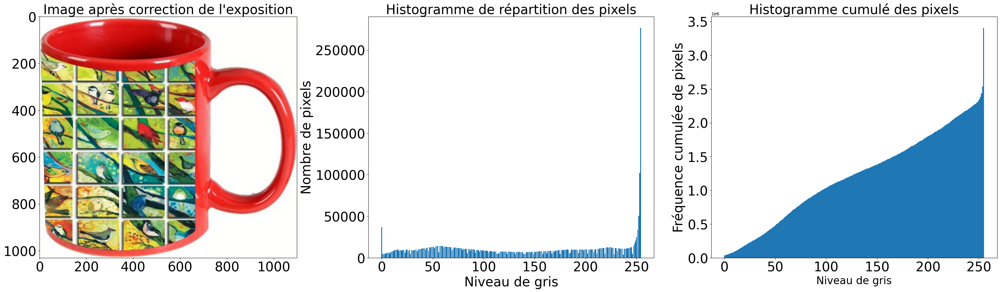

In [200]:
# Correction de l'exposition 
img_expo = ImageOps.autocontrast(img_orig, 1)
fcP6.afficher_image_histopixel(img_expo,'Image après correction de l\'exposition')

# 3.1.2.3 Correction du contraste (égalisation d'histogramme)

Le contraste caractérise la répartition de lumière dans une image : plus une image est contrastée, plus la différence de luminosité entre ses zones claires et sombres est importante. En général, une image peu contrastée est terne, tandis qu'une image trop contrastée est visuellement "agressive". Dans les deux cas, l'image manque de clarté car certains de ses détails seront peu, voire pas du tout, visibles.

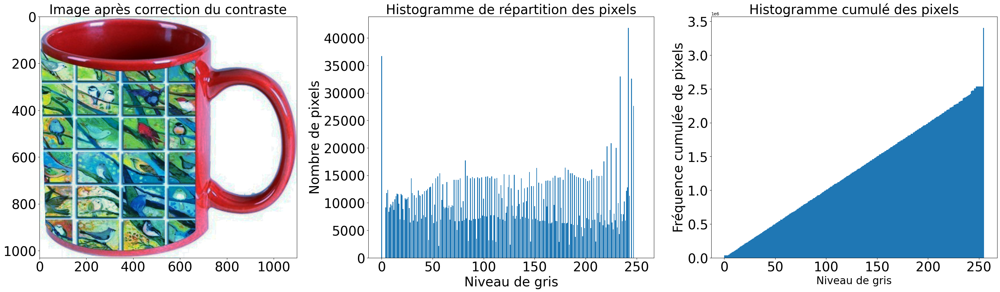

In [201]:
# Correction du contraste
img_contr_pils = ImageOps.equalize(img_expo)
fcP6.afficher_image_histopixel(img_contr_pils,'Image après correction du contraste')

# 3.1.2.4 Réduction du bruit (lissage)

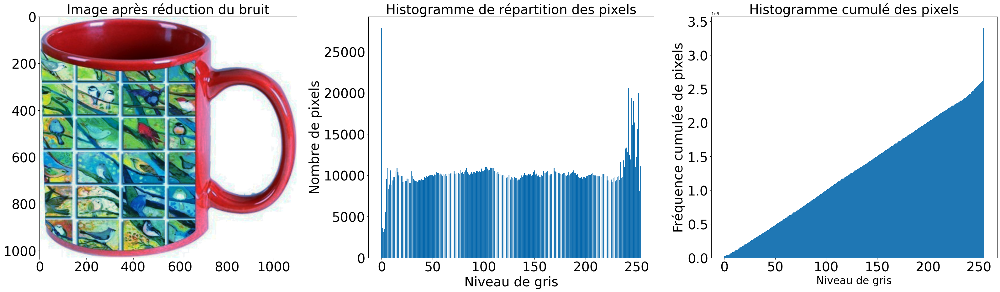

In [202]:
# Réduction du bruit (filtre)
img_filter = img_contr_pils.filter(ImageFilter.BoxBlur(1))
fcP6.afficher_image_histopixel(img_filter,'Image après réduction du bruit')

# 3.1.2.5 Convertir l'image en niveau de gris

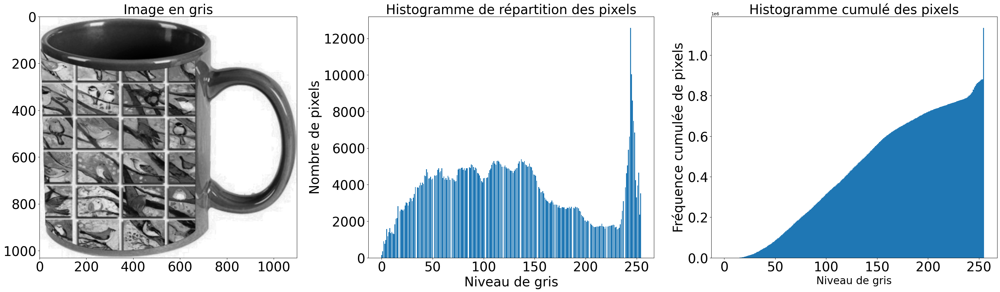

In [203]:
# Conversion de l'image en niveau de gris pour SIFT
img_gris = cv2.cvtColor(np.array(img_filter), cv2.COLOR_RGB2GRAY)
fcP6.afficher_image_histopixel(img_gris,'Image en gris')

# 3.1.2.6 Redimensionnement en 224 * 224

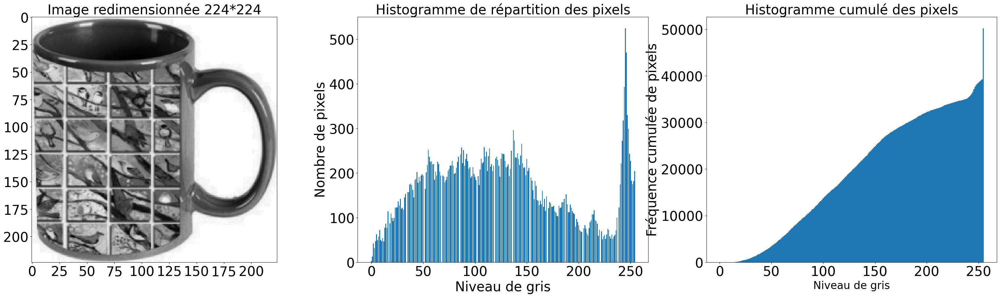

In [204]:
# Redimensionnement image contraste PILS
dim = (224, 224)
img_redim_pils = cv2.resize(np.array(img_gris), dim,
                            interpolation=cv2.INTER_AREA)
fcP6.afficher_image_histopixel(img_redim_pils,'Image redimensionnée 224*224')

# **3.2 Méthode SIFT**

- La méthode SIFT (Scale-Invariant Feature Transform) est une technique qui permet de détecter des points d'intérêt dans une image et de les décrire de manière robuste et invariante à l'échelle.

# 3.2.1 Création des descripteurs de chaque image

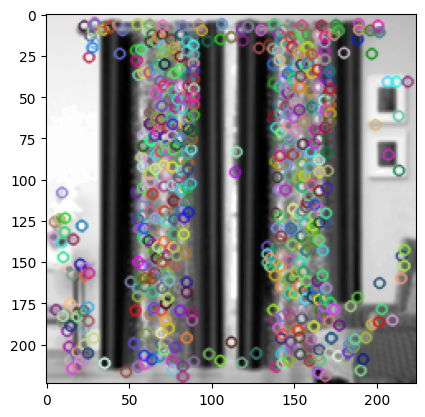

Descripteurs :  (619, 128)

[[ 0.  0. 31. ... 15. 29. 30.]
 [ 0.  1.  3. ...  0.  0.  0.]
 [20.  1.  0. ...  0.  0.  0.]
 ...
 [ 1.  0.  2. ...  0.  0.  7.]
 [38.  0.  0. ...  0.  0.  7.]
 [ 0.  0.  0. ...  0.  0.  0.]]


In [205]:
# Définir la nouvelle taille des images
new_width = 224
new_height = 224

sift = cv2.SIFT_create()
image_ = cv2.imread(image_test_path,0) # convert in gray
resized_img = cv2.resize(image_, (new_width, new_height))  # Redimensionner l'image
blur_img = cv2.GaussianBlur(resized_img, (5, 5), 0) # filtering noise
image = cv2.equalizeHist(blur_img)   # equalize image histogram
kp, des = sift.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp,image)
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)

- L'image_test contient 619 descripteurs sur l'image redimensionnée
- Chaque descripteur est un vecteur de longueur 128



# 3.2.2 Pré-traitement des images via SIFT

- Pour chaque image passage en gris et equalisation
- création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image
- création d'une liste de descripteurs pour l'ensemble des images ("sift_keypoints_all") qui sera utilisé pour créer les clusters de descripteurs


In [206]:
list_photos = data.image_path[0:5]
list_photos

0    C:/Users/misso/Desktop/Formation_DS_23_24_MERA...
1    C:/Users/misso/Desktop/Formation_DS_23_24_MERA...
2    C:/Users/misso/Desktop/Formation_DS_23_24_MERA...
3    C:/Users/misso/Desktop/Formation_DS_23_24_MERA...
4    C:/Users/misso/Desktop/Formation_DS_23_24_MERA...
Name: image_path, dtype: object

In [207]:
# Définir la nouvelle taille des images
new_width = 224
new_height = 224

# identification of key points and associated descriptors
sift_keypoints = []
temps1=time.time()
sift = cv2.SIFT_create()
list_photos = data.image_path

for image_num in tqdm(range(len(list_photos))) :
    # if image_num%100 == 0 : print(image_num)
    image_ = cv2.imread(list_photos[image_num],0) # convert in gray
    resized_img = cv2.resize(image_, (new_width, new_height))  # Redimensionner l'image
    # image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    blur_img = cv2.GaussianBlur(resized_img, (5, 5), 0) # filtering noise
    res = cv2.equalizeHist(blur_img)   # equalize image histogram
    kp, des = sift.detectAndCompute(res, None)
    sift_keypoints.append(des)

sift_keypoints_by_img = np.asarray(sift_keypoints,dtype=object)
sift_keypoints_all    = np.concatenate(sift_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

duration1=time.time()-temps1
print("temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")

100%|██████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:22<00:00, 45.84it/s]


Nombre de descripteurs :  (368797, 128)
temps de traitement SIFT descriptor :            22.94 secondes


# 3.2.3 Création des clusters de descripteurs

In [208]:
# Determination number of clusters
temps1=time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  607
Création de 607 clusters de descripteurs ...
temps de traitement kmeans :             9.10 secondes


# 3.2.4 Création des features des images

- Pour chaque image :
    - prédiction des numéros de cluster de chaque descripteur
    - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image
- Features d'une image = Histogramme d'une image = Comptage pour une image du nombre de descripteurs par cluster


In [209]:
# Creation of histograms (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for i, image_desc in enumerate(tqdm(sift_keypoints_by_img)) :
    # if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

100%|█████████████████████████████████████████████████████████████████████████████| 1050/1050 [00:01<00:00, 620.97it/s]

temps de création histogrammes :             1.69 secondes


In [210]:
im_sift_features = pd.DataFrame(im_features, index=data.uniq_id)
im_sift_features.to_csv('df_im_sift.csv', index=True)
im_sift_features

,0,1,2,3,4,5,6,7,8,9,...,597,598,599,600,601,602,603,604,605,606
uniq_id,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7,0.0,0.001616,0.000000,0.000000,0.000000,0.004847,0.003231,0.000000,0.000000,0.000000,...,0.000000,0.001616,0.003231,0.001616,0.003231,0.000000,0.001616,0.000000,0.001616,0.000000
7b72c92c2f6c40268628ec5f14c6d590,0.0,0.001678,0.000000,0.005034,0.000000,0.000000,0.000000,0.000000,0.005034,0.001678,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.003356,0.005034,0.000000,0.001678,0.003356
64d5d4a258243731dc7bbb1eef49ad74,0.0,0.010590,0.001513,0.000000,0.003026,0.000000,0.000000,0.000000,0.000000,0.001513,...,0.000000,0.000000,0.004539,0.001513,0.000000,0.006051,0.000000,0.000000,0.000000,0.000000
d4684dcdc759dd9cdf41504698d737d8,0.0,0.000000,0.001214,0.001214,0.002427,0.001214,0.003641,0.001214,0.003641,0.001214,...,0.002427,0.000000,0.000000,0.000000,0.002427,0.001214,0.000000,0.000000,0.003641,0.006068
6325b6870c54cd47be6ebfbffa620ec7,0.0,0.001233,0.001233,0.000000,0.000000,0.002466,0.000000,0.000000,0.007398,0.002466,...,0.000000,0.001233,0.000000,0.002466,0.000000,0.000000,0.002466,0.001233,0.006165,0.003699
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc,0.0,0.000000,0.005076,0.000000,0.000000,0.000000,0.002538,0.002538,0.000000,0.002538,...,0.000000,0.000000,0.002538,0.005076,0.005076,0.002538,0.002538,0.000000,0.007614,0.005076
fd6cbcc22efb6b761bd564c28928483c,0.0,0.000000,0.000000,0.004878,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.004878,0.000000,0.000000,0.000000,0.000000,0.004878,0.004878,0.000000,0.000000
5912e037d12774bb73a2048f35a00009,0.0,0.000000,0.000000,0.000000,0.000000,0.002155,0.000000,0.000000,0.000000,0.002155,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.002155,0.006466,0.000000,0.000000,0.000000


# 3.2.5 Réductions de dimension

# 3.2.5.1 Réduction de dimension PCA

- La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (97%)
- L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE


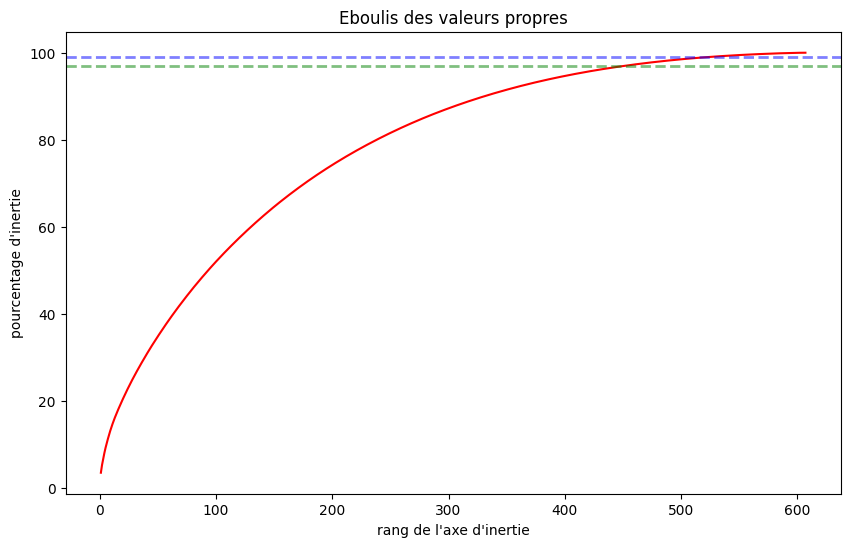

In [211]:
im_features_std = StandardScaler().fit_transform(im_features)
pca_1 = decomposition.PCA()
pca_1.fit(im_features_std)
scree = pca_1.explained_variance_ratio_*100
plt.figure(figsize=(10,6))
plt.plot(np.arange(len(scree))+1, scree.cumsum(),c="red")
plt.axhline(y=99, xmin=0, xmax=(len(scree))+1, linewidth=2, color = 'b', ls='--', alpha=0.5)
plt.axhline(y=97, xmin=0, xmax=(len(scree))+1, linewidth=2, color = 'g', ls='--', alpha=0.5)
plt.xlabel("rang de l'axe d'inertie")
plt.ylabel("pourcentage d'inertie")
plt.title("Eboulis des valeurs propres")
plt.show(block=False)

In [212]:
print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.97)
feat_pca= pca.fit_transform(im_features_std)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 607)
Dimensions dataset après réduction PCA :  (1050, 452)


# 3.2.5.2 Réduction de dimension T-SNE

- Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images

In [213]:
tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

df_tsne = pd.DataFrame(X_tsne[:,0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = data["label_name"]
print(df_tsne.shape)

(1050, 3)


In [214]:
df_tsne.head(3)

,tsne1,tsne2,class
0,2.490103,2.665812,Home Furnishing
1,-2.788203,-4.039583,Baby Care
2,2.225154,2.890400,Baby Care


# 3.2.6  Analyse visuelle : affichage T-SNE selon catégories d'images

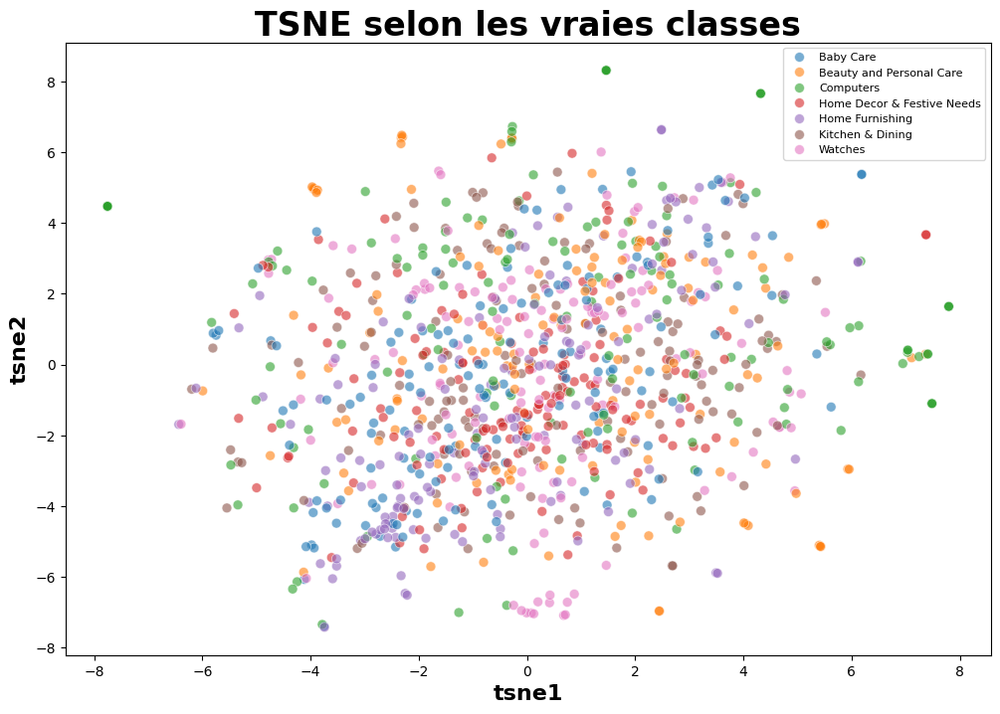

In [215]:
plt.figure(figsize=(12,8))
sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne, legend="brief",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

plt.title('TSNE selon les vraies classes', fontsize = 24, pad = 5, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 16, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 16, fontweight = 'bold')
plt.legend(prop={'size': 8}) 

plt.show()

# 3.2.7 Analyse de la similarité entre catégories et clusters

# 3.2.7.1 Création de clusters à partir du T-SNE

In [216]:
cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 4)


# 3.2.7.2 Affichage des images selon les clusters et calcul ARI de similarité catégories images / clusters

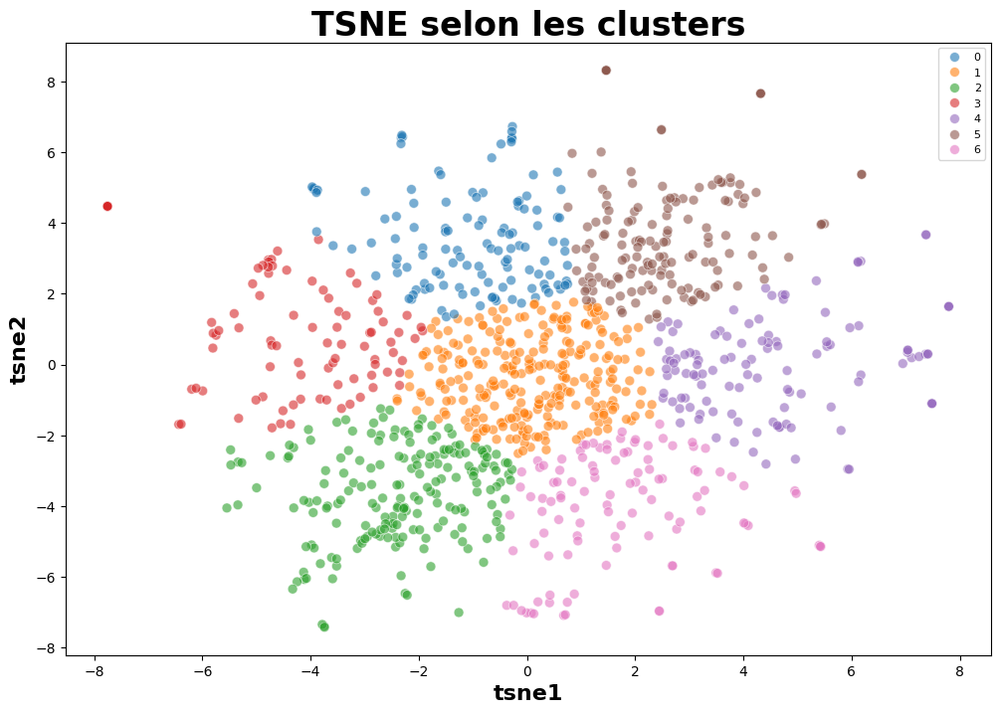

ARI :  0.02571346701801744


In [217]:
plt.figure(figsize=(12, 8))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")

plt.title('TSNE selon les clusters', fontsize = 24, pad = 5, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 16, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 16, fontweight = 'bold')
plt.legend(prop={'size': 8}) 

plt.show()

labels = data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

- **Le score ARI de 0.025 très faible**

# **3.3 Méthode CNN Transfer learning : étude de faisabilité**

# 3.3.1 Création du modèle pré-entraîné

- Ces deux lignes de code créent un modèle de réseau de neurones à convolution (CNN) basé sur l'architecture VGG16 pré-entraînée.

- La première ligne crée une instance du modèle VGG16 en utilisant la méthode VGG16() de Keras. VGG16 est un modèle CNN très populaire qui a été pré-entraîné sur un grand ensemble de données d'images pour résoudre la classification d'image. Il est composé de 13 couches de convolution et 3 couches entièrement connectées.

- La seconde ligne crée un nouveau modèle en utilisant la première couche jusqu'à l'avant-dernière couche du modèle VGG16 pré-entraîné. Cela signifie que la sortie de la dernière couche de la VGG16, qui est une couche entièrement connectée avec 1000 neurones correspondant aux classes d'objets, est supprimée. La sortie de ce nouveau modèle sera la sortie de la couche avant-dernière, qui est une représentation vectorielle de l'image.

- Ainsi, ce modèle peut être utilisé pour extraire des caractéristiques de haut niveau à partir d'images, qui peuvent ensuite être utilisées pour résoudre diverses tâches de vision par ordinateur telles que la classification d'images, la détection d'objets, etc.


In [218]:
base_model = VGG16()
model = Model(inputs=base_model.inputs, outputs=base_model.layers[-2].output)

print(model.summary())

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

# 3.3.2 Création des features des images

In [219]:
list_photos = data.image_path
images_features = []

for image_num in tqdm(range(len(list_photos))) :
    image_ = load_img(list_photos[image_num], target_size=(224, 224))
    image = img_to_array(image_) 
    image = np.expand_dims(image, axis=0)
    image = preprocess_input(image)
    images_features.append(model.predict(image, verbose=0)[0]) # predict from pretrained model

images_features = np.asarray(images_features)
images_features.shape

100%|██████████████████████████████████████████████████████████████████████████████| 1050/1050 [02:54<00:00,  6.03it/s]


(1050, 4096)

In [220]:
vgg16_features = pd.DataFrame(images_features, index=data.uniq_id)
vgg16_features.to_csv('df_vgg16_.csv', index=True)
vgg16_features

,0,1,2,3,4,5,6,7,8,9,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
uniq_id,,,,,,,,,,,,,,,,,,,,,
55b85ea15a1536d46b7190ad6fff8ce7,3.406277,0.857044,0.000000,1.095922,2.247915,2.956892,2.472737,0.000000,0.000000,0.000000,...,0.490017,0.0,0.000000,0.490316,0.867838,0.786627,0.000000,0.000000,0.865860,0.000000
7b72c92c2f6c40268628ec5f14c6d590,0.000000,0.000000,0.000000,1.197249,0.000000,0.000000,0.000000,0.000000,0.000000,6.487935,...,1.246727,0.0,0.000000,0.000000,0.000000,3.110524,0.000000,0.000000,0.000000,0.000000
64d5d4a258243731dc7bbb1eef49ad74,0.000000,0.000000,0.000000,4.445022,0.000000,0.000000,0.000000,0.000000,0.000000,2.834690,...,0.000000,0.0,0.000000,0.000000,0.000000,5.237413,0.000000,1.307145,0.000000,0.000000
d4684dcdc759dd9cdf41504698d737d8,0.000000,0.066488,0.000000,2.059556,0.000000,0.000000,0.000000,0.000000,0.000000,0.899686,...,0.000000,0.0,0.000000,0.000000,0.000000,3.959970,0.000000,0.000000,0.000000,0.000000
6325b6870c54cd47be6ebfbffa620ec7,3.321000,0.000000,0.000000,0.000000,1.000244,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.0,0.000000,0.000000,0.000000,9.229391,0.168791,0.000000,1.707684,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
958f54f4c46b53c8a0a9b8167d9140bc,2.325147,2.423030,0.000000,1.837191,3.089123,2.355725,0.000000,0.000000,1.430738,1.298516,...,0.000000,0.0,0.030517,0.000000,0.000000,0.000000,0.864257,1.107704,0.000000,0.000000
fd6cbcc22efb6b761bd564c28928483c,1.267138,0.377028,0.350578,0.000000,2.114948,0.000000,0.000000,0.782546,0.000000,3.532787,...,0.000000,0.0,0.751141,0.791058,0.000000,1.059228,0.000000,1.504048,0.000000,1.004964
5912e037d12774bb73a2048f35a00009,2.193175,2.396430,2.630247,0.962000,0.388435,0.552615,3.743579,0.000000,0.000000,0.000000,...,1.233734,0.0,0.000000,0.000000,0.000000,0.216964,0.579520,2.170724,0.185212,0.000000


# 3.3.3 Réduction dimension et analyse

 # 3.3.3.1 Réduction de dimension PCA

In [221]:
print(images_features.shape)
features_std = StandardScaler().fit_transform(images_features)
pca = decomposition.PCA(n_components=0.99, svd_solver='full')
feat_pca= pca.fit_transform(features_std)
print(feat_pca.shape)

(1050, 4096)
(1050, 850)


 # 3.3.3.2 Réduction de dimension T-SNE et affichage des images selon vraies classes

In [222]:
temps1 = time.time()

tsne = manifold.TSNE(n_components=2, perplexity=30,
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

duration1=time.time()-temps1
print("temps de T-SNE : ", "%15.2f" % duration1, "secondes")

temps de T-SNE :             6.84 secondes


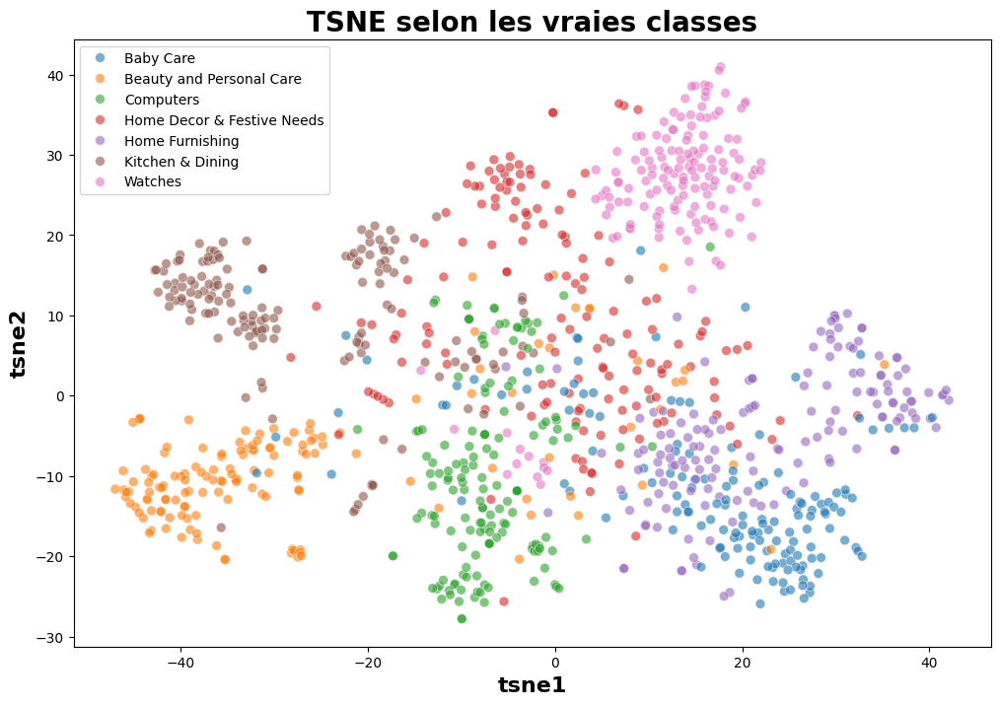

In [223]:
df_tsne = pd.DataFrame(X_tsne, columns=['tsne1', 'tsne2'])
df_tsne["class"] = data["label_name"]

plt.figure(figsize=(12, 8))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="class",
    palette=sns.color_palette('tab10', n_colors=7),
    s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")

plt.title('TSNE selon les vraies classes', fontsize = 20, fontweight = 'bold')
plt.xlabel('tsne1', fontsize = 16, fontweight = 'bold')
plt.ylabel('tsne2', fontsize = 16, fontweight = 'bold')
plt.legend(prop={'size': 10}) 

plt.show()

- L'analyse graphique montre visuellement qu'il est réalisable de séparer automatiquement les images selon leurs vraies classes
- Ceci suffit à démontrer la faisabilité de réaliser ultérieurement une classification supervisée pour déterminer automatiquement les classes des images
- Cette étape 1 est très rapide à mettre en oeuvre. Une conclusion négative sur la faisabilité aurait éviter de réaliser des traitements beaucoup plus lourd de classification supervisée
- Cette démarche en 2 étapes (1. Faisabilité, 2. Classification supervisée si étape 1 OK) s'inscrit dans une démarche agile de tout projet Datam



# 3.3.4 Création de clusters à partir du T-SNE et affichage des images selon clusters

- Attention : ici, il ne s'agit pas de faire une classification non supervisée, mais simplement, par une mesure de l'ARI, de conforter l'analyse graphique précédente qui démontre la faisabilité de réaliser ultérieurement une classification supervisée. Cette mesure de l'ARI nécessite de créer des clusters théoriques via KMeans
- Il s'agit donc de réaliser une mesure de ce que nous voyons graphiquement, donc à partir des données en sortie du t-sne
- Pour réaliser une classification non supervisée, il aurait fallu repartir des données avant t-sne
- Dans la démarche en 2 étapes, il n'est pas utile de réaliser une classification non supervisée, une classification supervisée est bien plus performante. Même le calcul de l'ARI n'est pas indispensable, nous pourrions passer directement du graphique t-sne précédent à l'étape 2 de classification supervisée
- Il n'est donc pas utile de passer du temps à optimiser l'ARI, un ordre de grandeur suffit pour conforter le 1er graphique t-sne. D'ailleurs la meilleure solution de feature engineering ne génère pas toujours le meilleur ARI. L'analyse graphique t-sne est bien plus riche d'enseignement



In [224]:
cls = cluster.KMeans(n_clusters=7, n_init=100)
cls.fit(X_tsne)

KMeans(n_clusters=7, n_init=100)

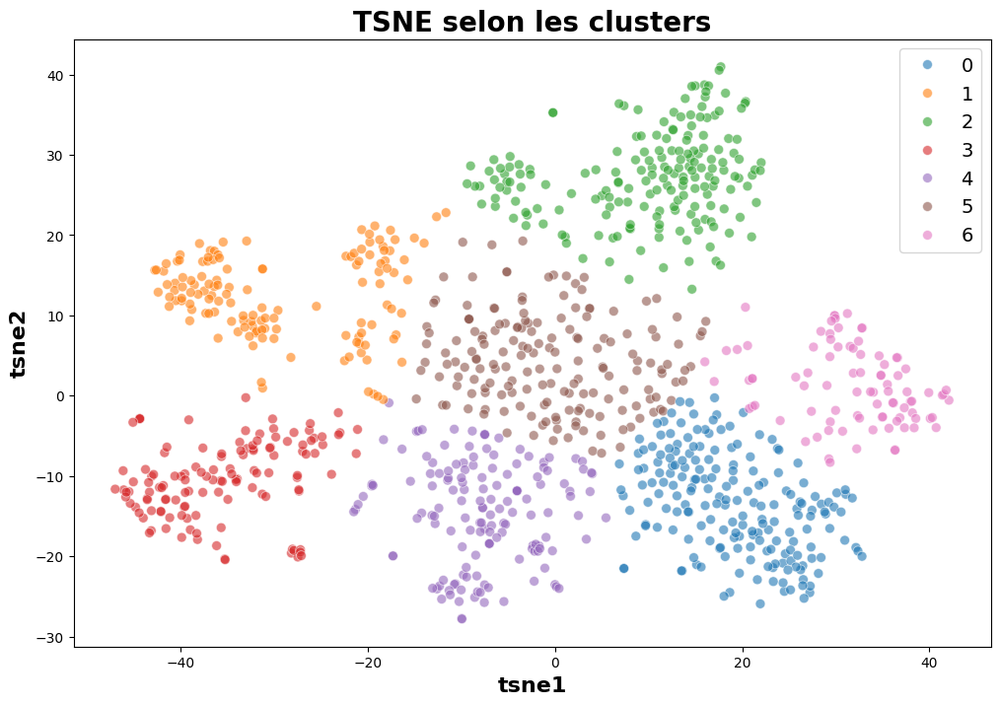

ARI :  0.47167261573082303


In [225]:
df_tsne["cluster"] = cls.labels_

plt.figure(figsize=(12, 8))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")

plt.title('TSNE selon les clusters', fontsize=20, fontweight='bold')
plt.xlabel('tsne1', fontsize=16, fontweight='bold')
plt.ylabel('tsne2', fontsize=16, fontweight='bold')
plt.legend(prop={'size': 14}) 

plt.show()

labels = data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))


- Plusieurs approches ont été testées, les meilleurs résultats sont obtenus par le modèle CNN Transfer Learning. **On obtient un ARI de 0.47**

 # **Partie 4 : Etude de faisabilité via les données textuelles et images**

In [226]:
tfv_features = tfv_features.reset_index()
tfv_features.drop(columns=['uniq_id'], inplace=True)

In [227]:
tfv_features.shape

(1050, 3667)

In [228]:
df_images_features = pd.DataFrame(images_features)

In [229]:
df_images_features.shape

(1050, 4096)

In [230]:
df_img_text = pd.concat([tfv_features,df_images_features], axis=1)
df_img_text

,aaa,aapno,aari,aarika,abil,abl,abod,abras,abroad,absolut,...,4086,4087,4088,4089,4090,4091,4092,4093,4094,4095
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.490017,0.0,0.000000,0.490316,0.867838,0.786627,0.000000,0.000000,0.865860,0.000000
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.246727,0.0,0.000000,0.000000,0.000000,3.110524,0.000000,0.000000,0.000000,0.000000
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.000000,0.000000,0.000000,5.237413,0.000000,1.307145,0.000000,0.000000
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.000000,0.000000,0.000000,3.959970,0.000000,0.000000,0.000000,0.000000
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.000000,0.000000,0.000000,9.229391,0.168791,0.000000,1.707684,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.030517,0.000000,0.000000,0.000000,0.864257,1.107704,0.000000,0.000000
1046,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.0,0.751141,0.791058,0.000000,1.059228,0.000000,1.504048,0.000000,1.004964
1047,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.233734,0.0,0.000000,0.000000,0.000000,0.216964,0.579520,2.170724,0.185212,0.000000
1048,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.961305,0.0,2.180535,2.697891,0.000000,0.000000,0.000000,0.000000,0.229053,0.922095


In [231]:
ARI_img_text, X_tsne_img_text, labels_img_text = fcP6.ARI_fct_tsne(df_img_text.values, liste_cat, df_cat["label"])

ARI :  0.4448 time :  8.0


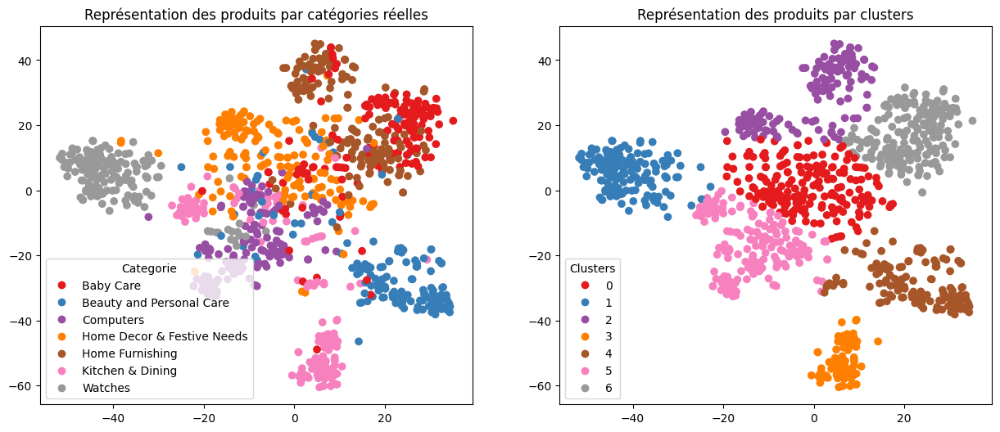

ARI :  0.4448


In [232]:
fcP6.TSNE_visu_fct(X_tsne_img_text, liste_cat, df_cat["label"], labels_img_text, ARI_img_text)

# 4.1 Réduction de dimension ACP :

In [233]:
print("Dimensions dataset avant réduction PCA : ", df_img_text.values.shape)
pca = PCA(n_components=0.99)
feat_pca_img_text = pca.fit_transform(df_img_text.values)
print("Dimensions dataset après réduction PCA : ", feat_pca_img_text.shape)

Dimensions dataset avant réduction PCA :  (1050, 7763)
Dimensions dataset après réduction PCA :  (1050, 803)


In [234]:
ARI_img_text2, X_tsne_img_text2, labels_img_text2 = fcP6.ARI_fct_tsne(feat_pca_img_text, liste_cat, df_cat["label"])

ARI :  0.4744 time :  7.0


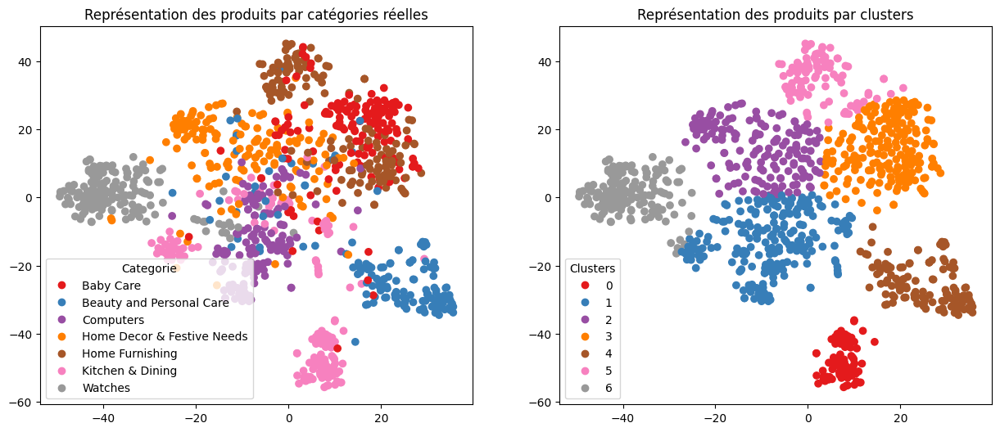

ARI :  0.4744


In [235]:
fcP6.TSNE_visu_fct(X_tsne_img_text2, liste_cat, df_cat["label"], labels_img_text2, ARI_img_text2)

- On obtient une amélioration de l'ARI (0.4744) après avoir effectué une réduction de dimension via ACP puis une projection TSNE à 2 composantes.

- On constate cependant toujours que les clusters ont séparé les différentes catégories de manière plus simplifiée que leur représentation réélle. La plupart des catégories se mélangent plus dans la représentation réelle. D'autres clusters semblent un peu mieux déterminés, ce sont les catégories qui semblent les plus espacées dans la représentation réelle comme celles évoquées précédemment.


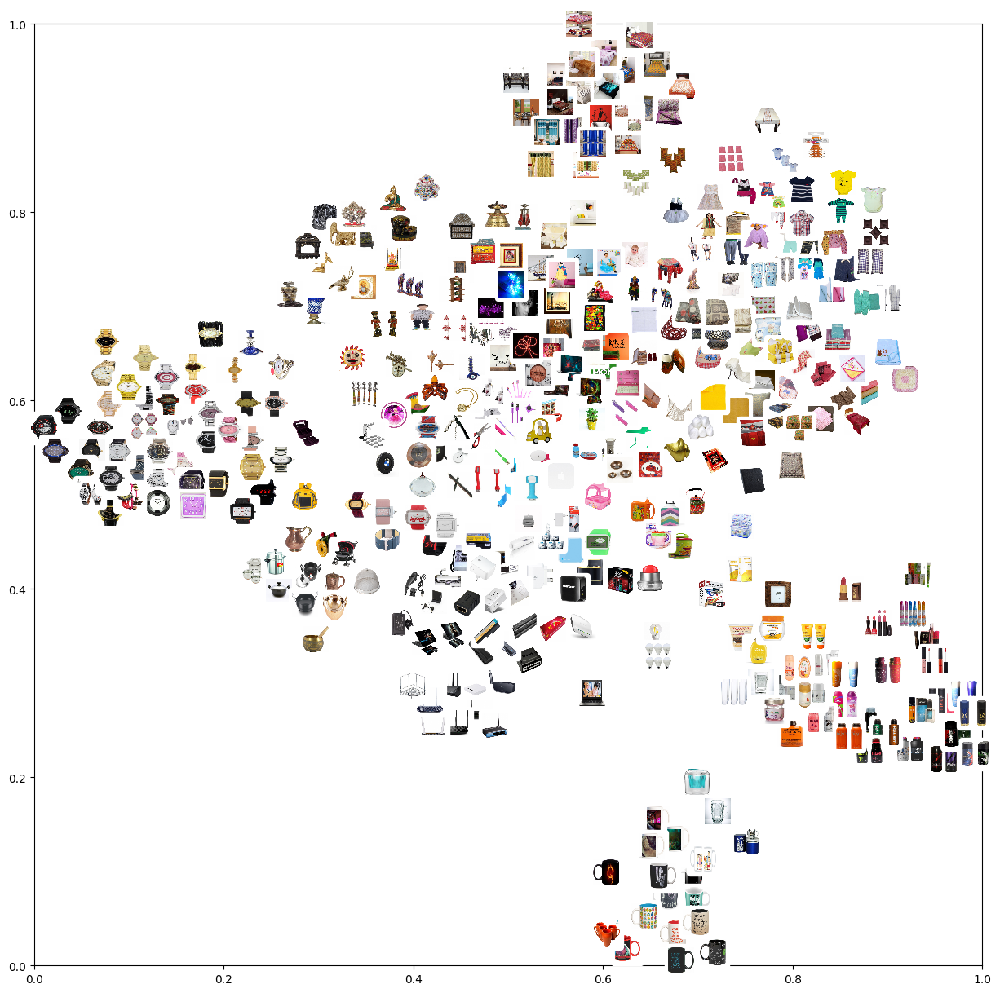

In [236]:
fcP6.plot_TSNE_images(X_tsne_img_text2, df_cat, path_images)

# **4.2 Conclusion**

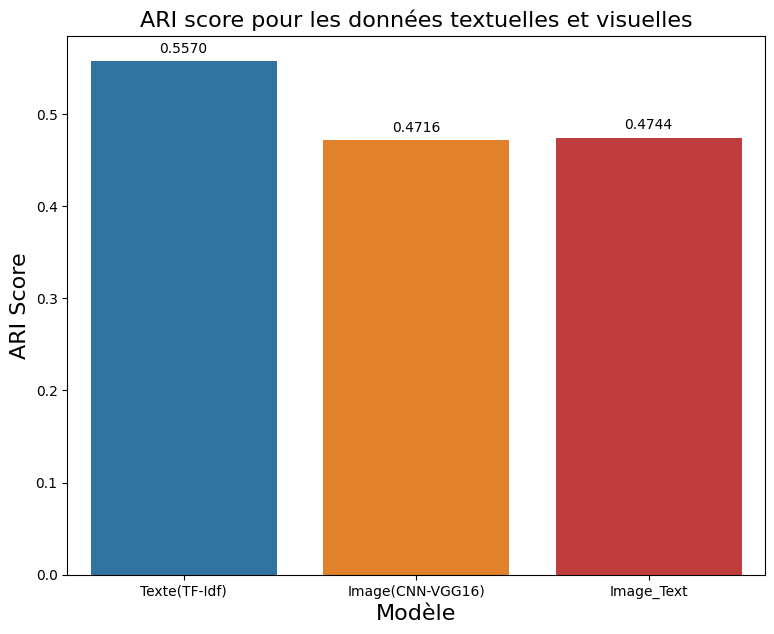

In [240]:

model_ = ['Texte(TF-Idf)','Image(CNN-VGG16)', 'Image_Text']
ari_ = [0.5570,0.4716,0.4744]
colors = ['blue','red','yellow','orange','green']
dataf = pd.DataFrame({"model_":model_, "ari_":ari_})
plt.figure(figsize = (9, 7))
splot = sns.barplot(x = "model_", y = "ari_", data=dataf,color = 'blue',
                    palette = ['tab:blue', 'tab:orange', 'tab:red', 'tab:yellow'])

for g in splot.patches:
    splot.annotate(format(g.get_height(), '.4f'),
                   (g.get_x() + g.get_width() / 2., g.get_height()),
                   ha = 'center', va = 'center',
                   xytext = (0, 9),
                   textcoords = 'offset points')

plt.xlabel("Modèle",fontsize=16)
plt.ylabel("ARI Score",fontsize=16)
plt.title('ARI score pour les données textuelles et visuelles', fontsize=16)
plt.show()
plt.show()

**Les données textuelles offrent le ARI le plus élevé.**